<a href="https://colab.research.google.com/github/Oleksy1121/Car-damage-detection/blob/main/training/YOLOv8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Установка и предварительная настройка
Скрипт устанавливает и настраивает библиотеку YOLO (You Only Look Once) для задач обнаружения объектов. Кроме того, импортируются необходимые библиотеки для обработки изображений и визуализации результатов.

In [ ]:
# Install neccesary libraries
!pip install ultralytics --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.8/898.8 kB 18.4 MB/s eta 0:00:00


In [ ]:
# Import the YOLO library and other necessary libraries
from ultralytics import YOLO
import os
from IPython.display import display, Image
import yaml
import cv2
import matplotlib.pyplot as plt
import random
import matplotlib.patches as patches
from PIL import Image as PILImage
import cv2
import glob
import numpy as np

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# Загрузка и подготовка данных
Скрипт берет набор данных из Roboflow, распаковывает его, а затем изменяет пути к обучающим, валидационным и тестовым коллекциям в файле YAML, чтобы они соответствовали местоположениям на диске.

In [ ]:
# Download the dataset and unzip it
!curl -L "https://app.roboflow.com/ds/t6xM6xE9bF?key=ym8EYKP9vQ" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   904  100   904    0     0   3191      0 --:--:-- --:--:-- --:--:--  3194
100 17.3M  100 17.3M    0     0  12.3M      0  0:00:01  0:00:01 --:--:-- 30.8M
Archive:  roboflow.zip
  inflating: README.dataset.txt      
  inflating: README.roboflow.txt     
  inflating: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/07-is-250-came-to-my-car-saw-a-big-crack-in-the-rear-v0-epzwgdws1iaa1_webp.rf.f8fa8c1e25c320516c8be752fc2c6fbe.jpg  
 extracting: test/images/073_jpg.rf.9fb7792655a0d1aeb80a19d88d2216c2.jpg  
 extracting: test/images/077_jpg.rf.27e0ff0931694f718ff9ce851b1a7ae9.jpg  
 extracting: test/images/1150_jpg.rf.e2a4e07bcca74f8c0a698a4181be1d18.jpg  
 extracting: test/images/116260-IMG_9532_JPG_jpg.rf.ca2bf7ea5490c16f6a5284e5640de9e3.jpg  
 extracting: test/images/20240608_211701_jp

In [ ]:
# Path to the data YAML file
data_yaml = "/content/data.yaml"

# Open and read data from the YAML file
with open(data_yaml, 'r') as file:
    data = yaml.safe_load(file)

# Modify values for train, validation, and test datasets
data['train'] = "/content/train/images"
data['val'] = "/content/valid/images"
data['test'] = "/content/test/images"

# Save the modified data back to the YAML file
with open(data_yaml, 'w') as file:
    yaml.dump(data, file)

# Загрузка и визуализация аннотаций
Сценарий определяет функции для загрузки имен классов и их цветов из файла YAML, а затем отображает аннотированные изображения, которые могут быть в формате bounding YOLO или многоугольников.

In [ ]:
# Load and visualize annotations

def load_class_names_and_colors(yaml_path):
    # Load class names and define colors for each class from a YAML file
    with open(yaml_path, 'r') as file:
        data = yaml.safe_load(file)
    names = data['names']
    colors = ['red', 'blue', 'green', 'yellow', 'purple', 'orange', 'aqua', 'grey']  # Define colors for classes
    return names, dict(zip(names, colors))

def display_images_with_annotations(image_folder_path, num_images=8, yaml_path=data_yaml):
    # Display images with annotations
    class_names, class_colors = load_class_names_and_colors(yaml_path)
    annotations_folder_path = image_folder_path.replace('/images', '/labels')
    image_files = [f for f in os.listdir(image_folder_path) if f.endswith('.jpg')]

    # Check if there are enough images to display
    if len(image_files) < num_images:
        print("Not enough images available.")
        num_images = len(image_files)
        if num_images == 0:
            print("No images to display.")
            return  # Exit function if no images are available

    random.shuffle(image_files)

    fig, axs = plt.subplots(1, num_images, figsize=(5 * num_images, 5))
    for i, file in enumerate(image_files[:num_images]):
        img_path = os.path.join(image_folder_path, file)
        ann_path = os.path.join(annotations_folder_path, file.replace('.jpg', '.txt'))
        img = PILImage.open(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')

        draw_annotations(axs[i], ann_path, img.size, class_names, class_colors)

    plt.show()

def draw_annotations(ax, annotation_path, image_size, class_names, class_colors):
    # Draw annotations on an image
    with open(annotation_path, 'r') as file:
        for line in file:
            parts = line.strip().split()
            class_id = int(parts[0])
            class_name = class_names[class_id]
            color = class_colors[class_name]
            if len(parts) == 5:  # YOLO bounding boxes
                draw_yolo_bbox(ax, parts, image_size, class_name, color)
            else:  # Polygon coordinates
                draw_polygon(ax, parts, image_size, class_name, color)

def draw_yolo_bbox(ax, parts, image_size, class_name, color):
    # Draw YOLO format bounding box
    x_center = float(parts[1]) * image_size[0]
    y_center = float(parts[2]) * image_size[1]
    width = float(parts[3]) * image_size[0]
    height = float(parts[4]) * image_size[1]
    x_min = x_center - width / 2
    y_min = y_center - height / 2
    rect = patches.Rectangle((x_min, y_min), width, height, linewidth=2, edgecolor=color, facecolor='none')
    ax.add_patch(rect)
    ax.text(x_min, y_min - 10, class_name, color='white', fontsize=12, backgroundcolor=color)

def draw_polygon(ax, parts, image_size, class_name, color):
    # Draw polygon annotation
    points = list(map(float, parts[1:]))
    polygon = [(points[i] * image_size[0], points[i + 1] * image_size[1]) for i in range(0, len(points), 2)]
    poly_shape = patches.Polygon(polygon, linewidth=2, edgecolor=color, facecolor='none')
    ax.add_patch(poly_shape)
    ax.text(polygon[0][0], polygon[0][1] - 10, class_name, color='white', fontsize=12, backgroundcolor=color)

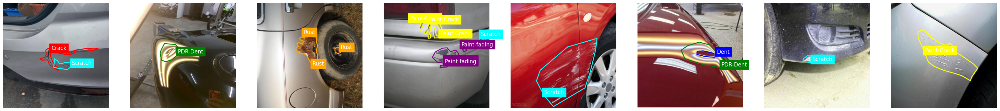

In [ ]:
# Example function call
display_images_with_annotations(data['train'])

# Обучение модели YOLOv8
Сценарий обучает модель YOLOv8 на основе предоставленного файла конфигурации YAML

In [ ]:
# Train the YOLOv8 model with specified parameters
!yolo task=detect mode=train model=yolov8m.pt data="/content/data.yaml" epochs = 100 imgsz = 640 batch = -1

100% 49.7M/49.7M [00:00<00:00, 143MB/s]
Ultralytics 8.3.47 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/data.yaml, epochs=100, time=None, patience=100, batch=-1, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels

# Результаты обучения модели

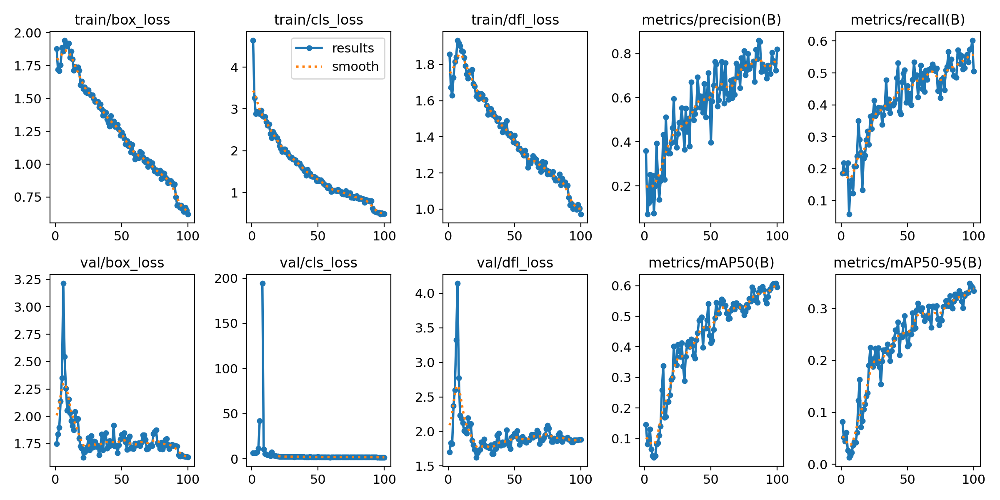

In [ ]:
# Display training results image
display(Image(filename='/content/runs/detect/train/results.png'))

#Матрица ошибок

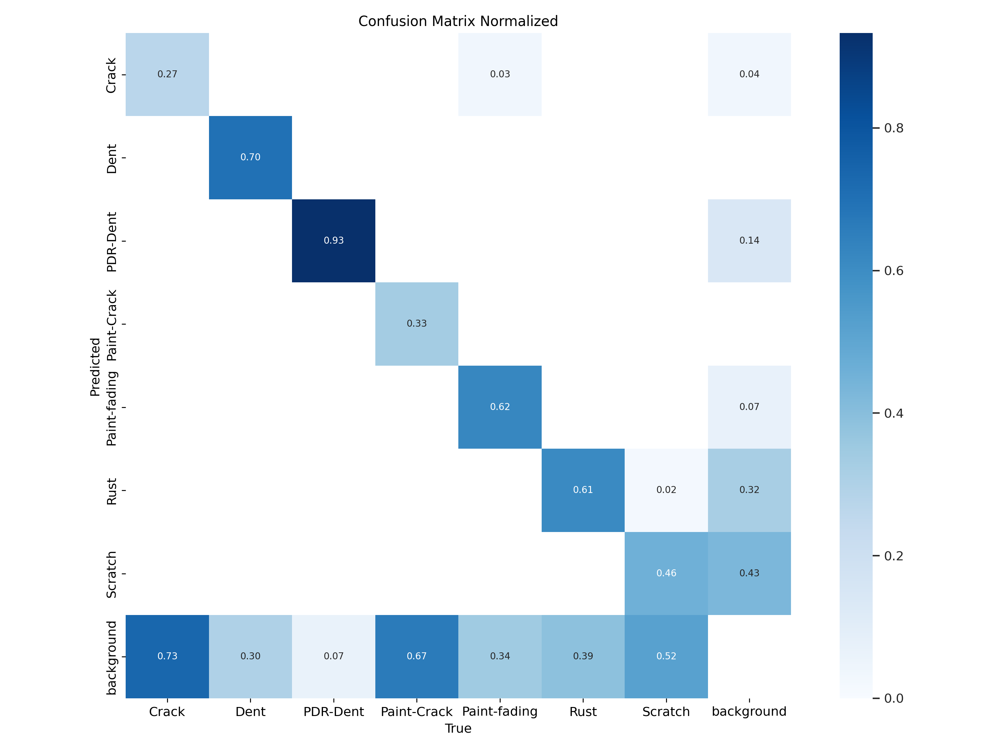

In [ ]:
# Display confusion matrix image
display(Image(filename='/content/runs/detect/train/confusion_matrix_normalized.png'))

# Оценка модели YOLOv8
Скрипт выполняет оценку обученной модели YOLOv8, загружая лучшие веса модели и отображая различные оценочные кривые, такие как кривая F1, кривая PR, кривая точности и кривая чувствительности, а также нормализованную матрицу ошибок.

In [ ]:
# Evaluate the YOLOv8 model with specified parameters
!yolo val model='/content/runs/detect/train/weights/best.pt' data='/content/data.yaml' imgsz=640

Ultralytics 8.3.47 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25,843,813 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/valid/labels.cache... 69 images, 0 backgrounds, 0 corrupt: 100% 69/69 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 5/5 [00:03<00:00,  1.51it/s]
                   all         69        141      0.762      0.574      0.605      0.348
                 Crack          7         15      0.664      0.264      0.285      0.222
                  Dent         10         10      0.981        0.7      0.782      0.598
              PDR-Dent         13         15      0.804      0.933      0.974       0.47
           Paint-Crack          5          6          1       0.45      0.503      0.226
          Paint-fading         15         29      0.861      0.621      0.695      0.434
                  Rust          9         18      0.431      0.611 

#Кривые оценки

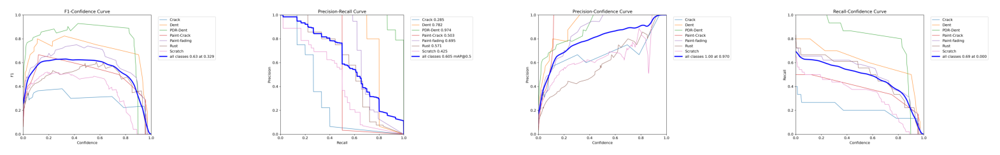

In [ ]:
# Sample paths to four evaluation images
img_paths = [
    '/content/runs/detect/val/F1_curve.png',
    '/content/runs/detect/val/PR_curve.png',
    '/content/runs/detect/val/P_curve.png',
    '/content/runs/detect/val/R_curve.png'
]

# Create a subplot with 1 row and 4 columns
fig, axs = plt.subplots(1, 4, figsize=(20, 5))  # Adjust the figure size as needed

# Display each image in the subplot
for ax, img_path in zip(axs, img_paths):
    img = PILImage.open(img_path)
    ax.imshow(img)
    ax.axis('off')  # Turn off the axis for better readability
plt.show()

#Матрица ошибок

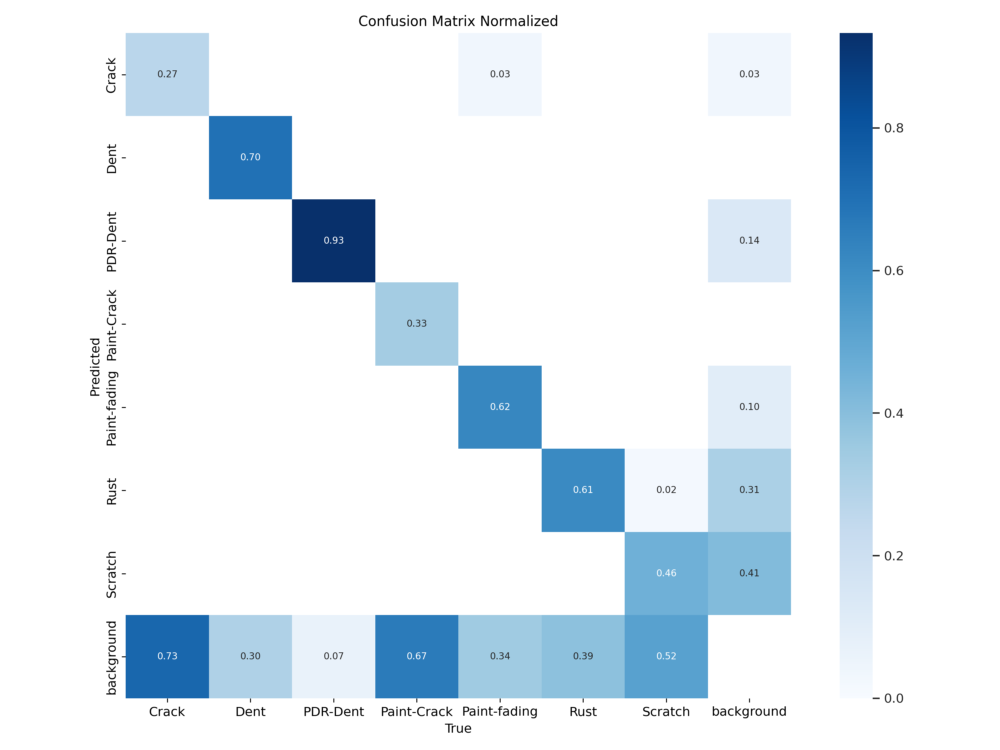

In [ ]:
# Display the confusion matrix image
display(Image(filename='/content/runs/detect/val/confusion_matrix_normalized.png'))

# Загрузка и прогнозирование с использованием модели YOLOv8
Скрипт загружает обученную модель YOLOv8 и выполняет предсказания на тестовом наборе. На изображениях нарисованы границы и метки для обнаруженных объектов, которые затем отображаются.


0: 640x640 1 Paint-fading, 1 Rust, 37.3ms
Speed: 8.1ms preprocess, 37.3ms inference, 839.0ms postprocess per image at shape (1, 3, 640, 640)


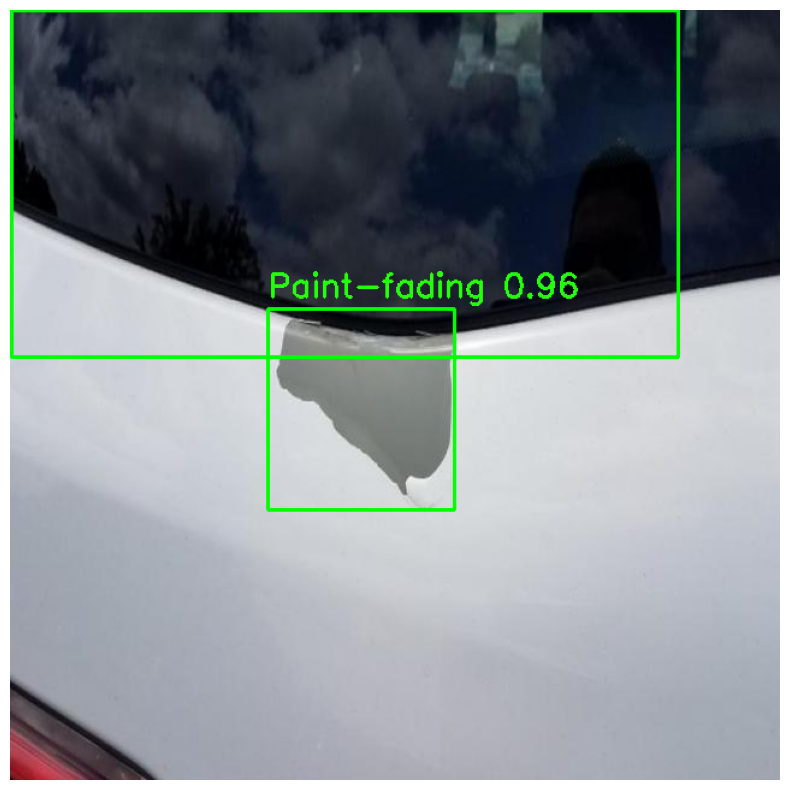


0: 640x640 2 Dents, 37.1ms
Speed: 3.4ms preprocess, 37.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


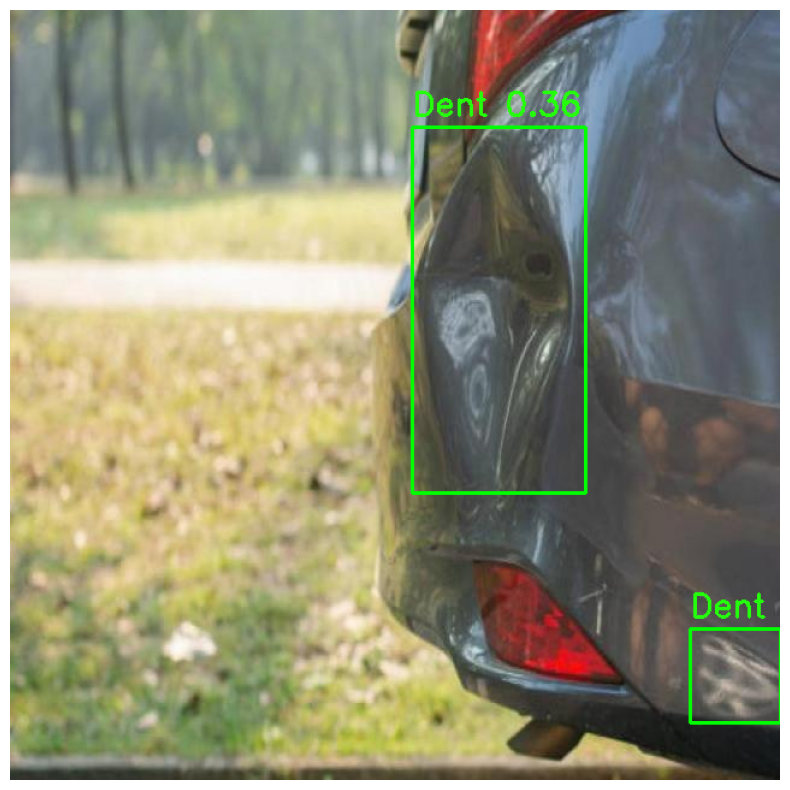


0: 640x640 1 Paint-fading, 1 Scratch, 37.1ms
Speed: 2.1ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


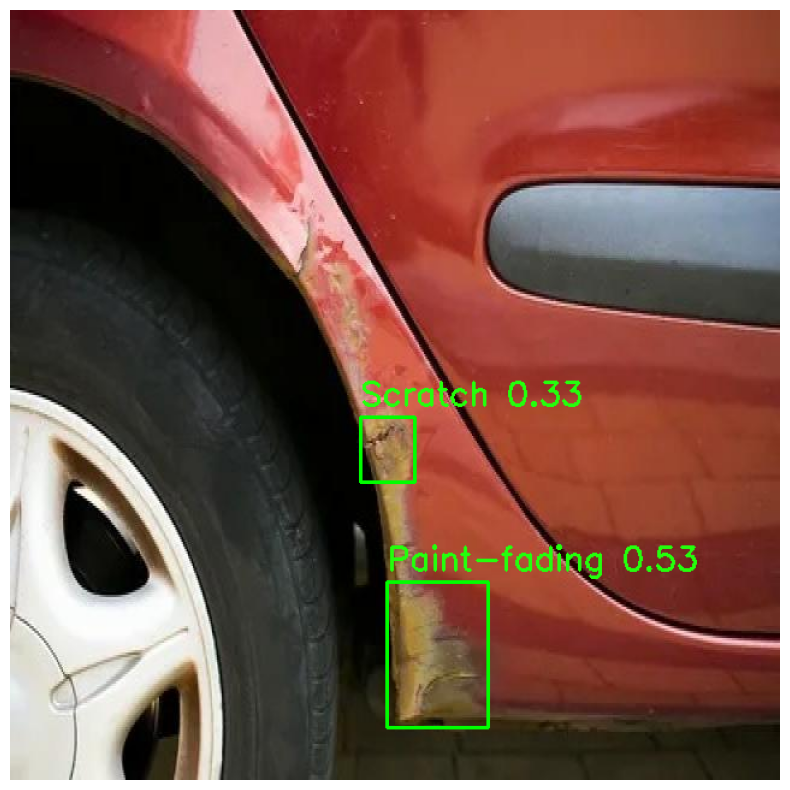


0: 640x640 1 Crack, 37.1ms
Speed: 2.6ms preprocess, 37.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


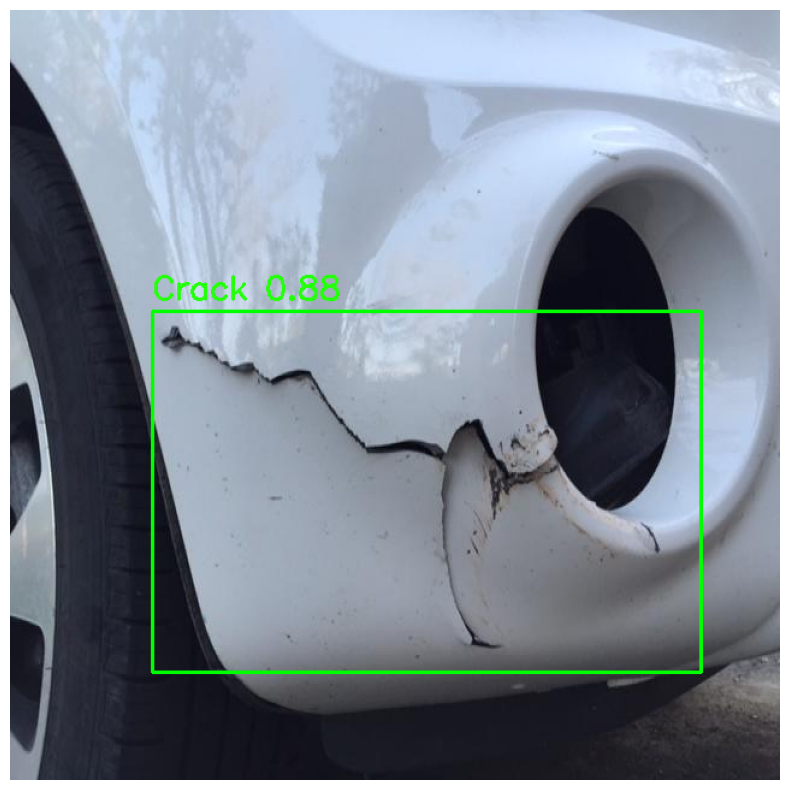


0: 640x640 5 Scratchs, 37.1ms
Speed: 2.3ms preprocess, 37.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


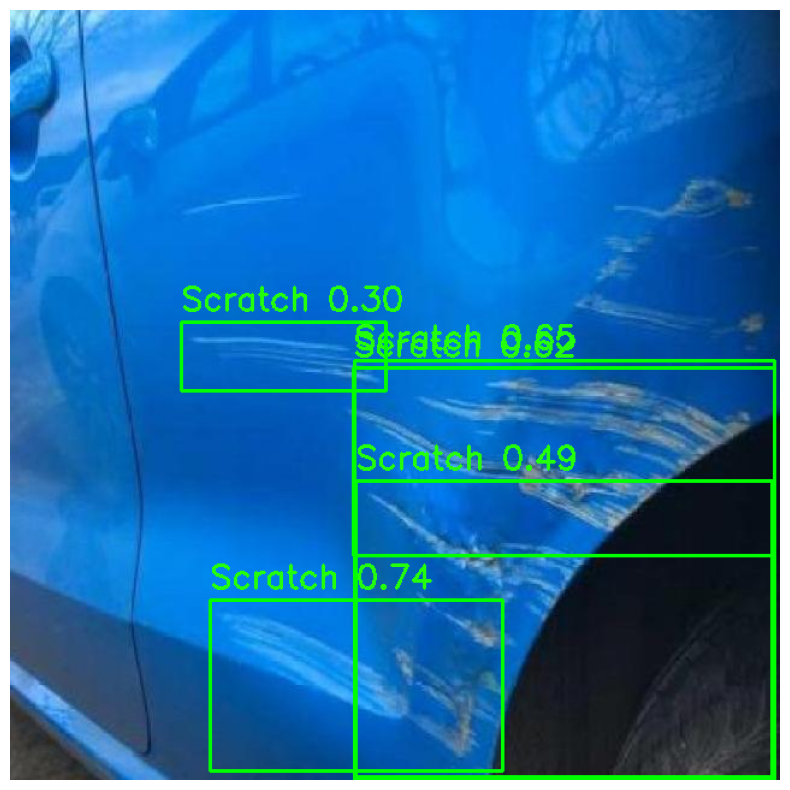


0: 640x640 2 PDR-Dents, 2 Scratchs, 37.1ms
Speed: 2.2ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


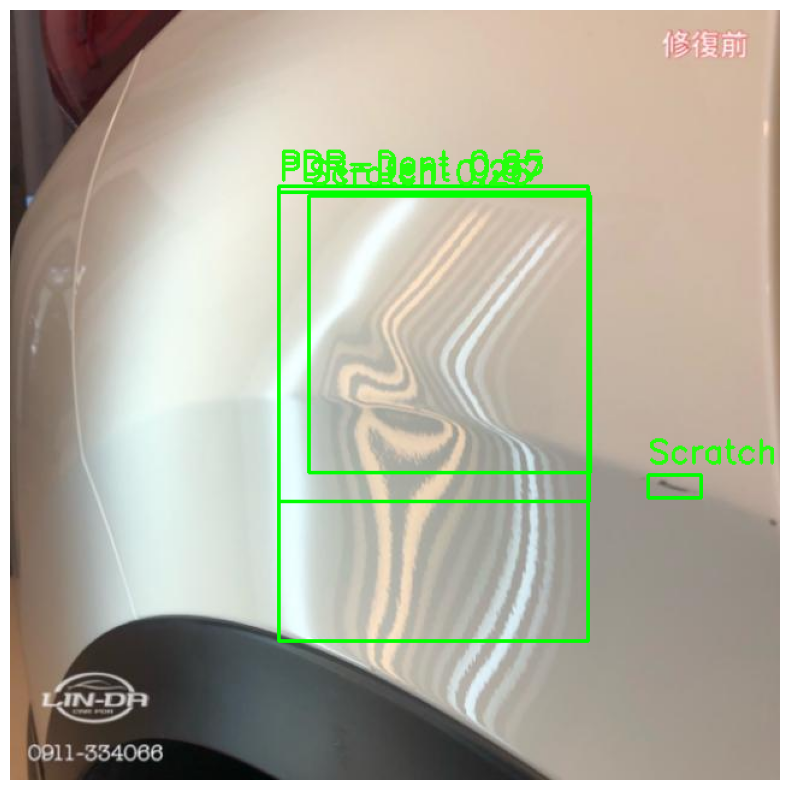


0: 640x640 1 Crack, 37.4ms
Speed: 2.1ms preprocess, 37.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


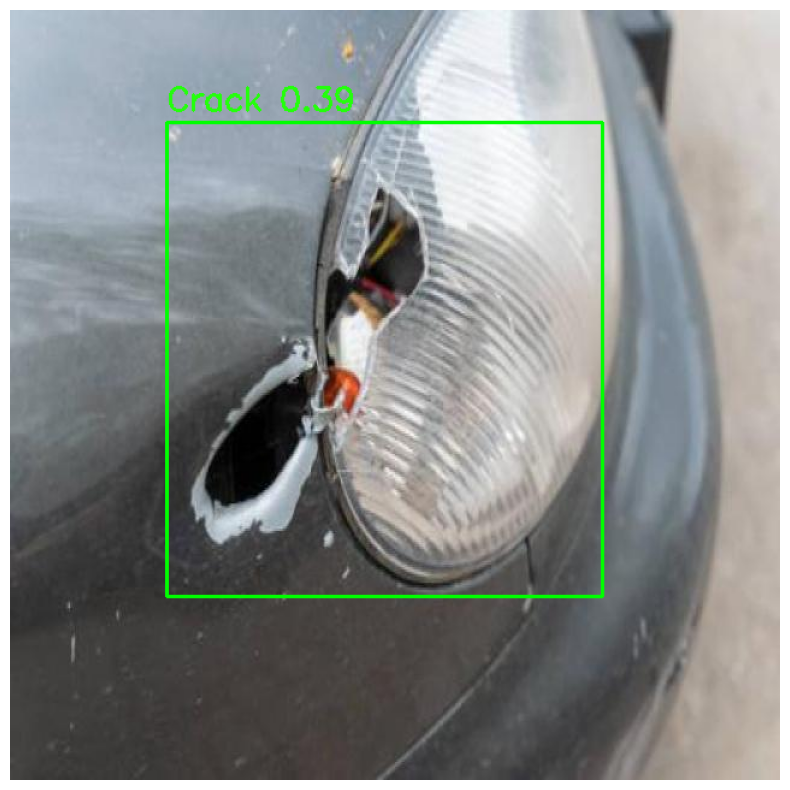


0: 640x640 (no detections), 37.9ms
Speed: 2.2ms preprocess, 37.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


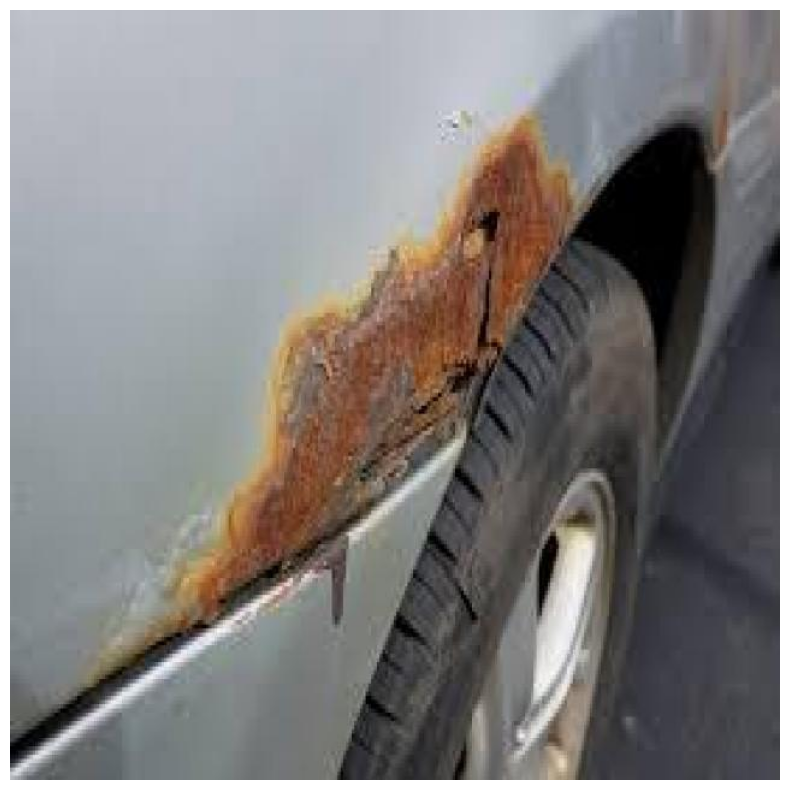


0: 640x640 1 Paint-Crack, 37.1ms
Speed: 2.7ms preprocess, 37.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


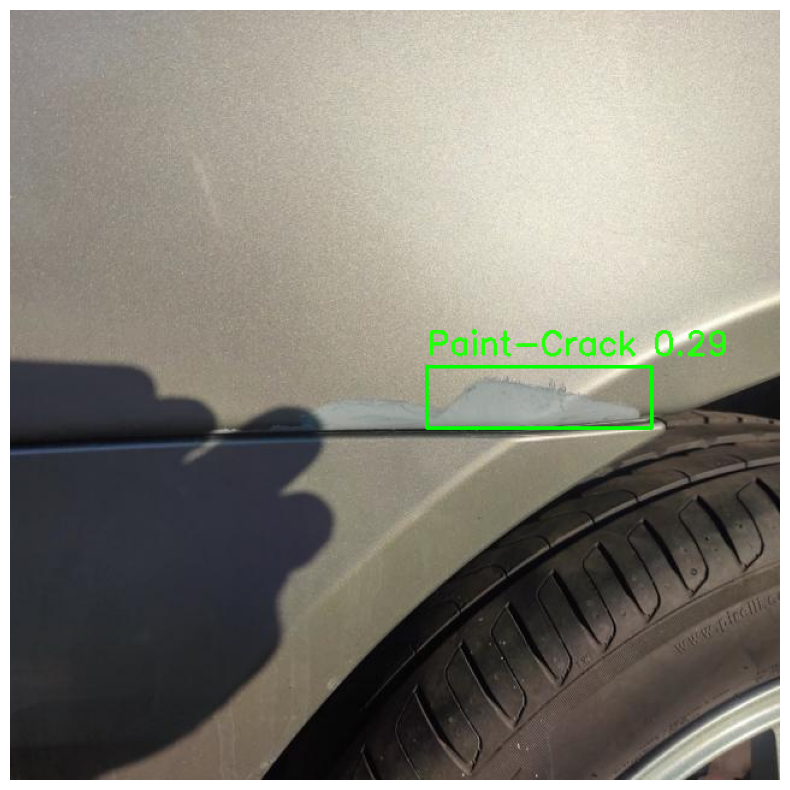


0: 640x640 1 Paint-fading, 37.1ms
Speed: 2.0ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


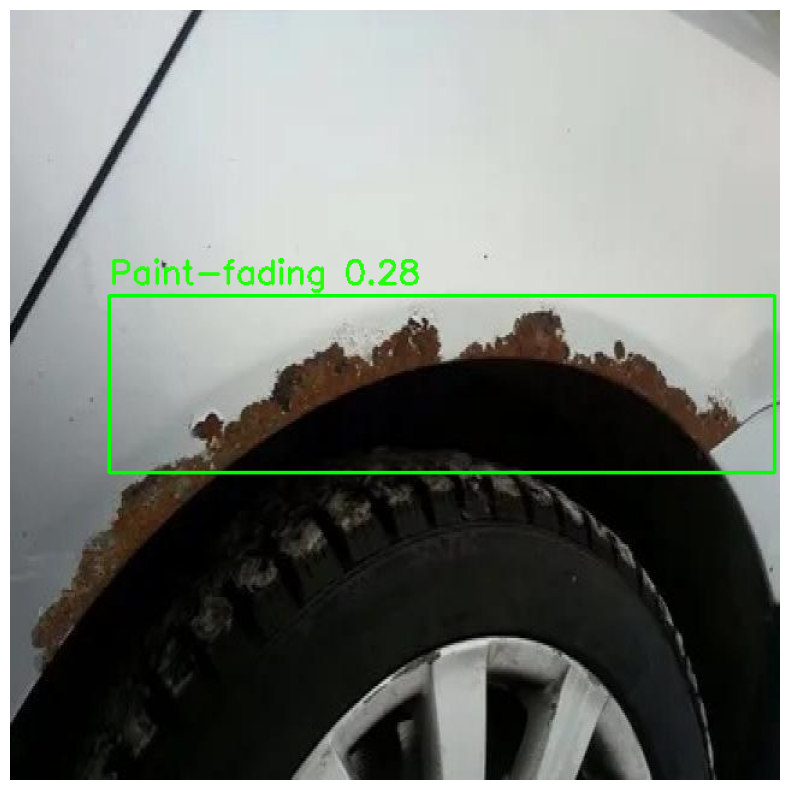


0: 640x640 (no detections), 37.1ms
Speed: 4.0ms preprocess, 37.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


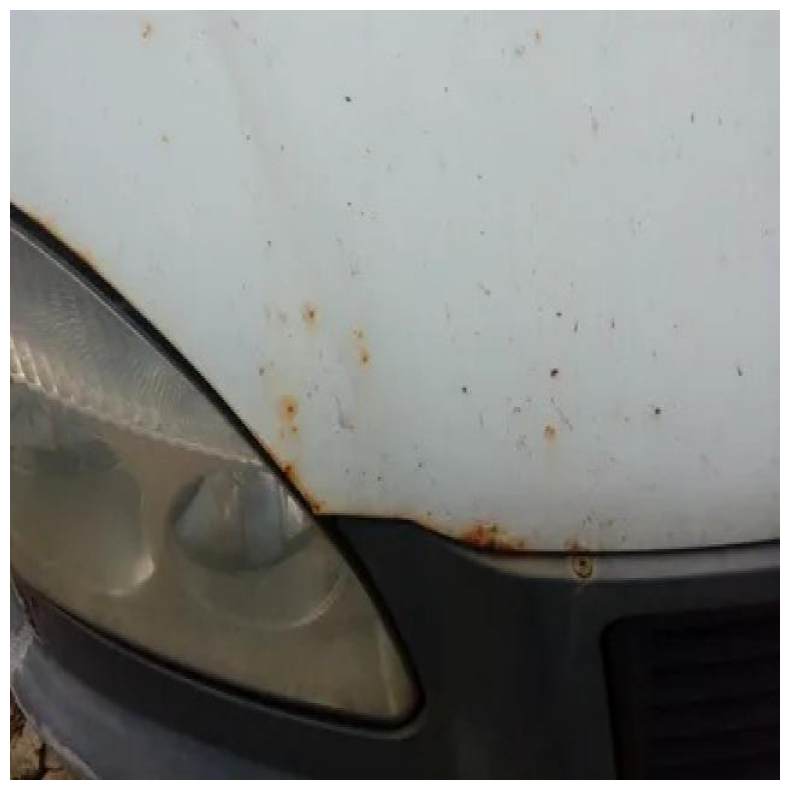


0: 640x640 1 Crack, 37.2ms
Speed: 2.1ms preprocess, 37.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


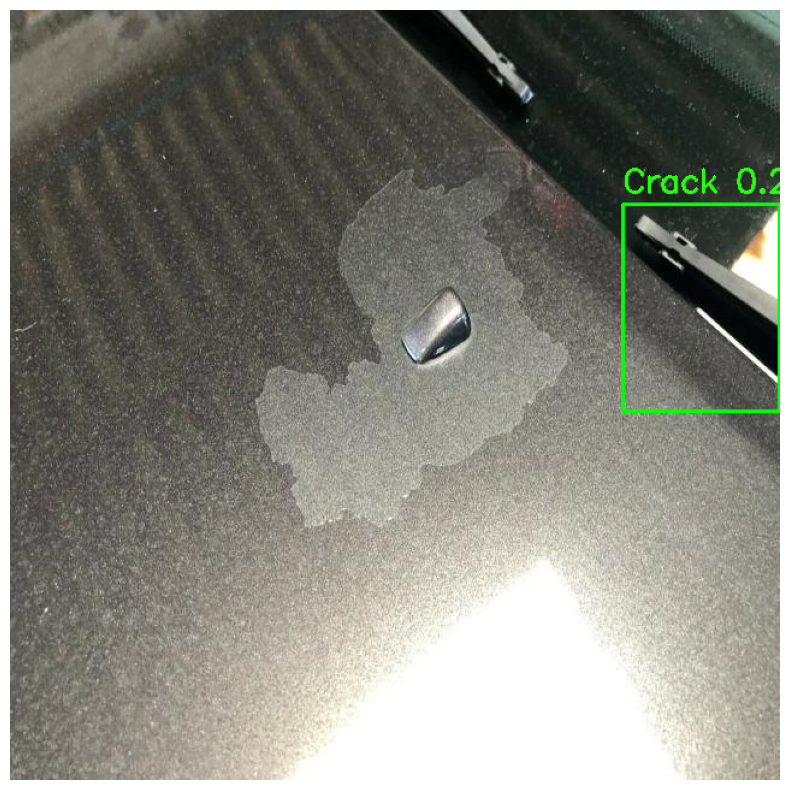


0: 640x640 1 Crack, 1 Scratch, 37.1ms
Speed: 2.0ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


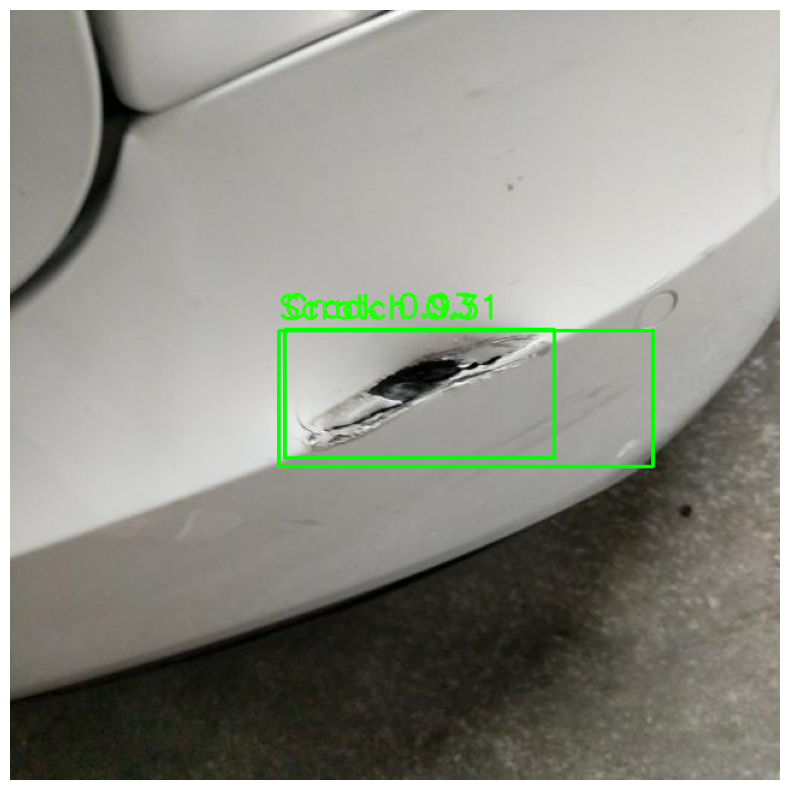


0: 640x640 (no detections), 37.1ms
Speed: 2.3ms preprocess, 37.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


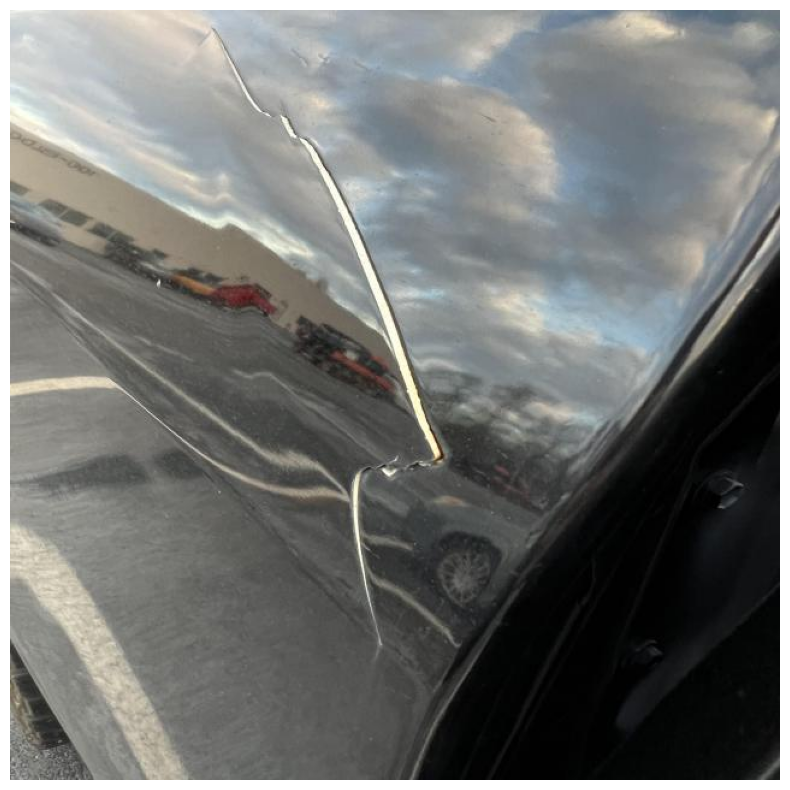


0: 640x640 1 Rust, 1 Scratch, 37.2ms
Speed: 2.0ms preprocess, 37.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


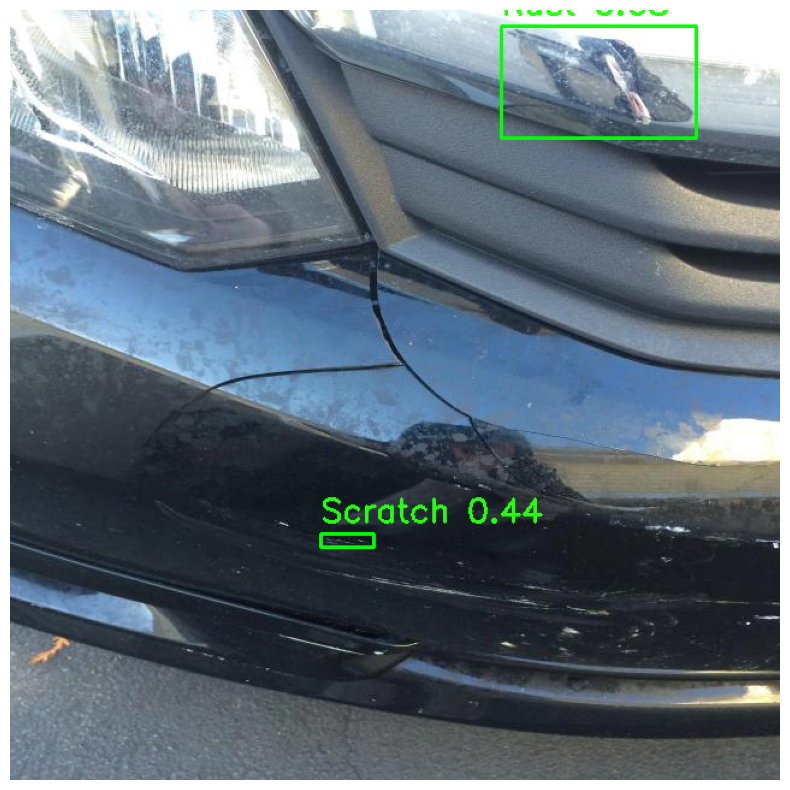


0: 640x640 3 PDR-Dents, 37.1ms
Speed: 7.1ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


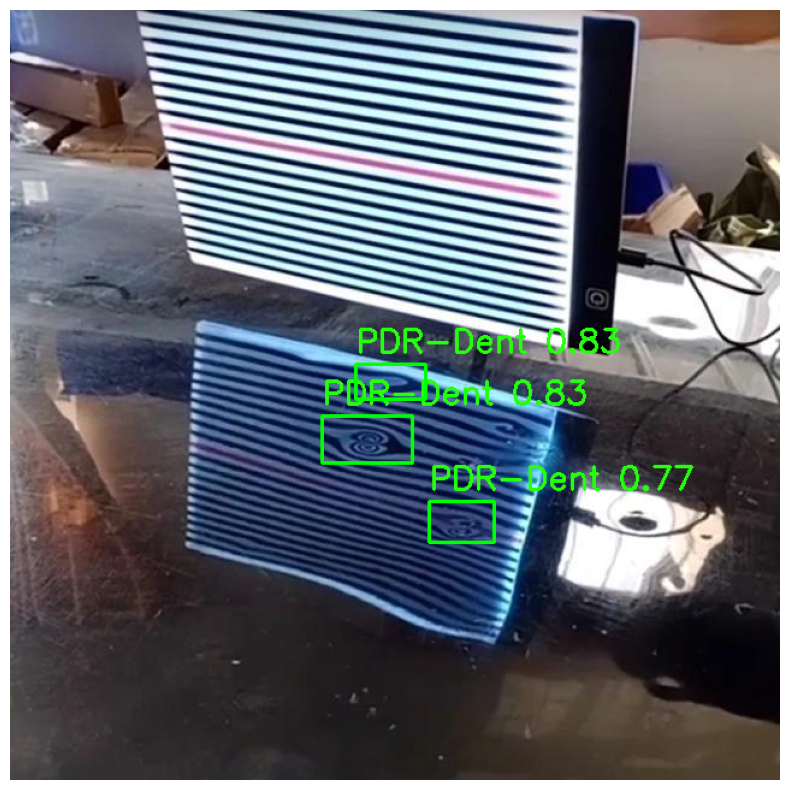


0: 640x640 1 Paint-fading, 4 Rusts, 37.1ms
Speed: 2.0ms preprocess, 37.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


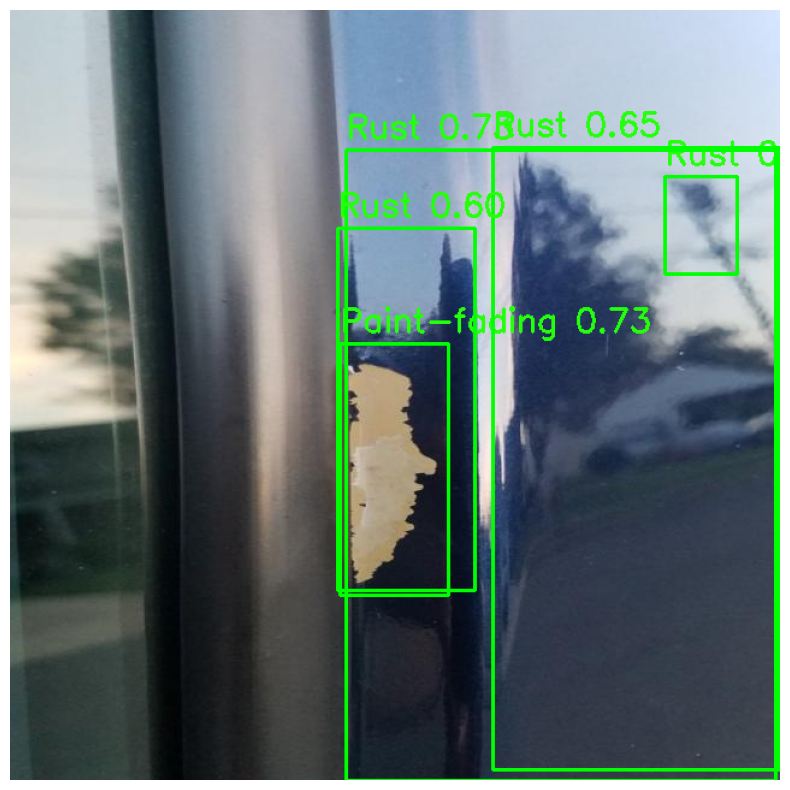


0: 640x640 1 Crack, 1 Rust, 37.1ms
Speed: 2.0ms preprocess, 37.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


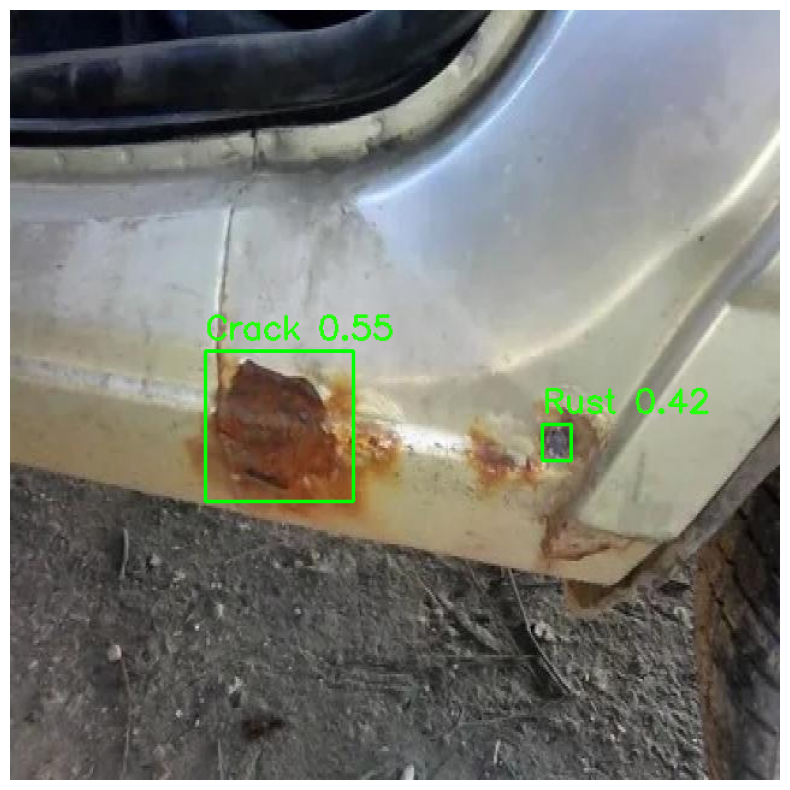


0: 640x640 2 Paint-fadings, 1 Rust, 37.8ms
Speed: 2.8ms preprocess, 37.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


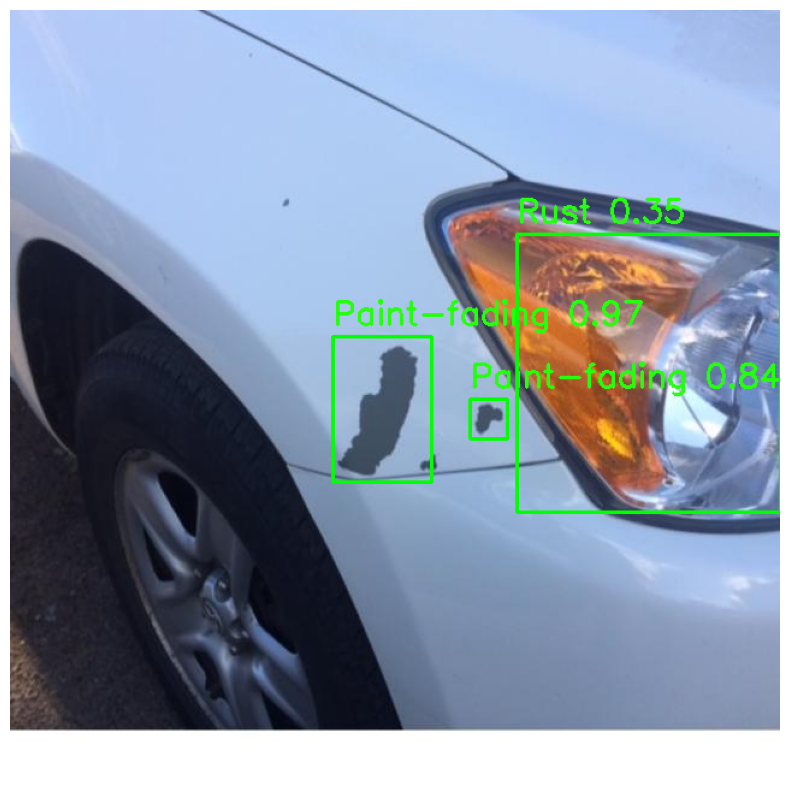


0: 640x640 1 Dent, 37.1ms
Speed: 2.3ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


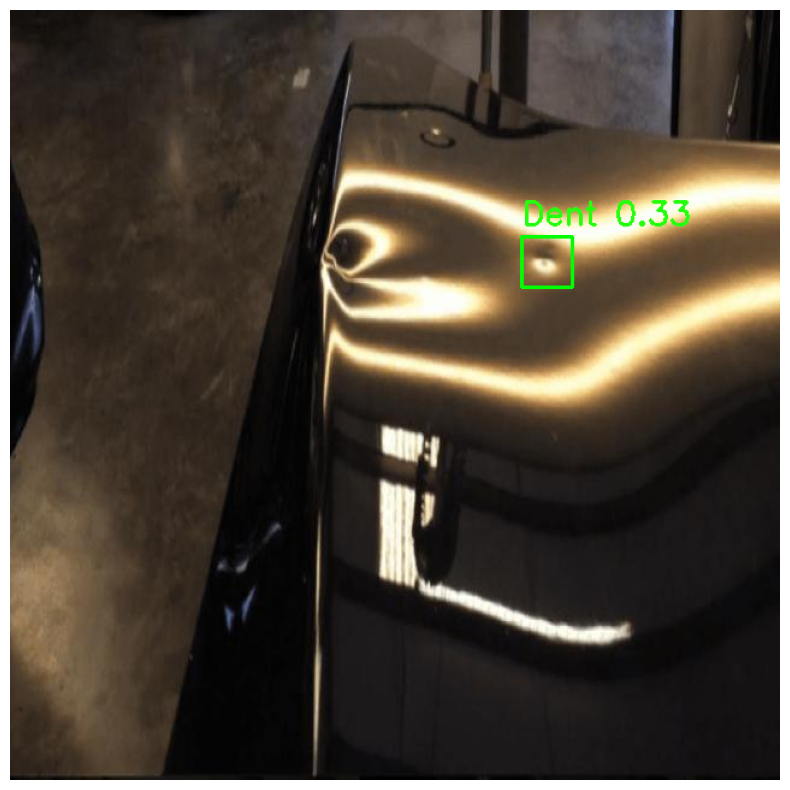


0: 640x640 1 PDR-Dent, 37.9ms
Speed: 2.2ms preprocess, 37.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


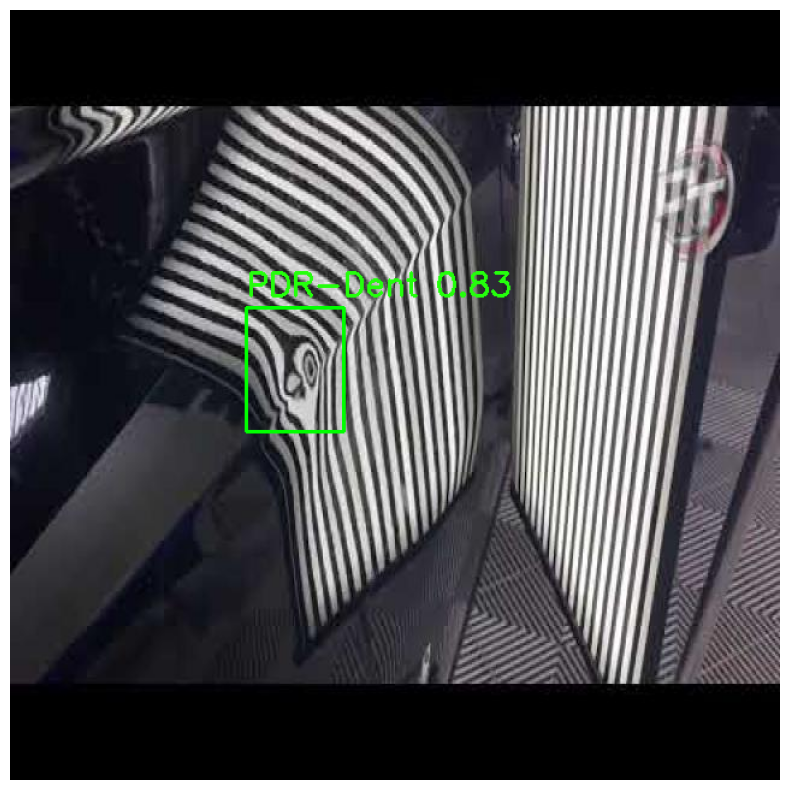


0: 640x640 1 Paint-Crack, 37.1ms
Speed: 2.1ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


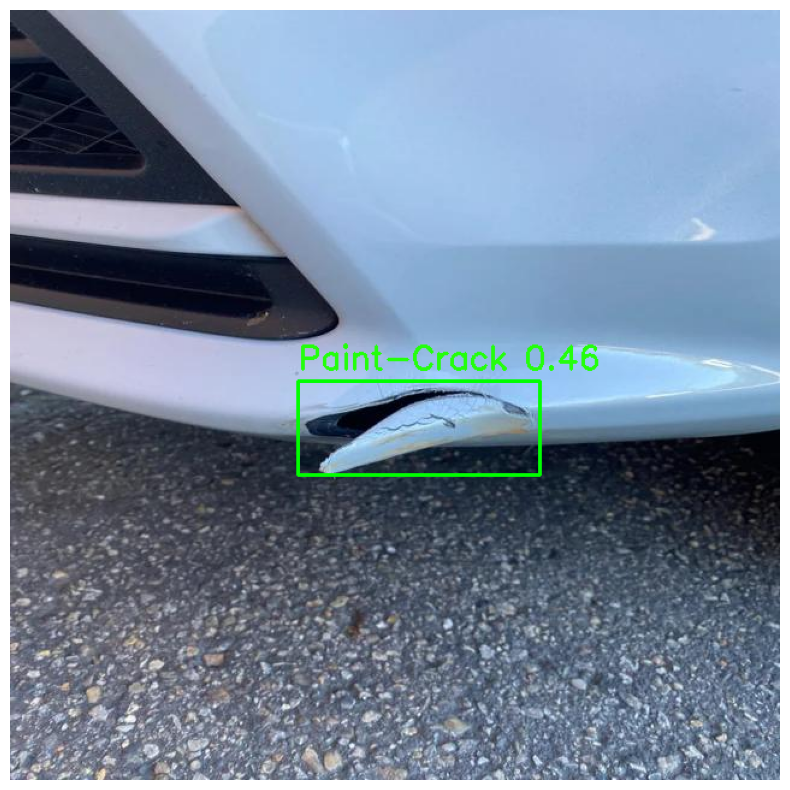


0: 640x640 (no detections), 37.1ms
Speed: 2.4ms preprocess, 37.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


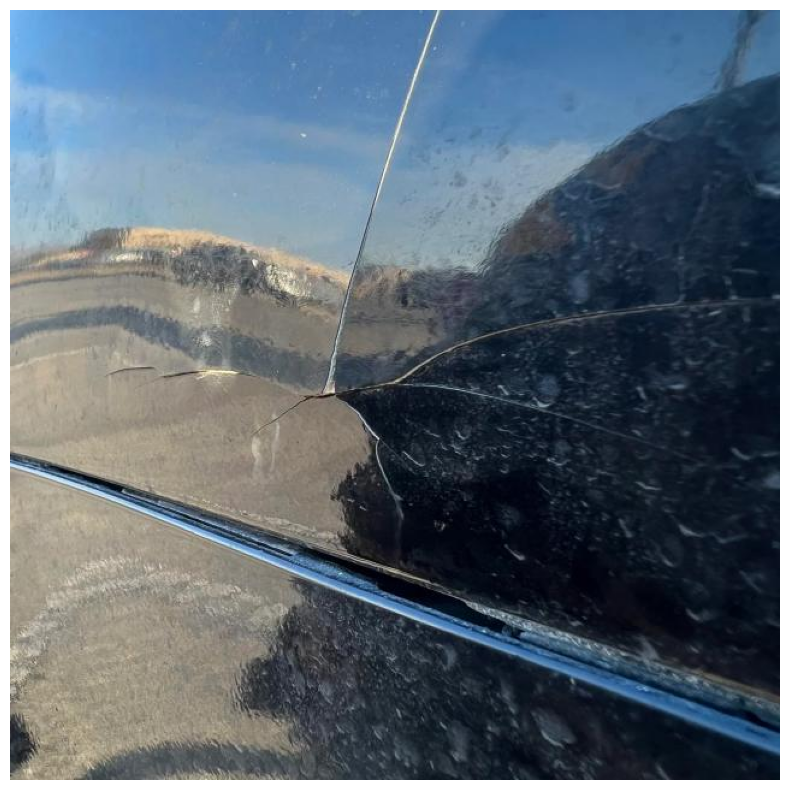


0: 640x640 1 Scratch, 37.1ms
Speed: 2.1ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


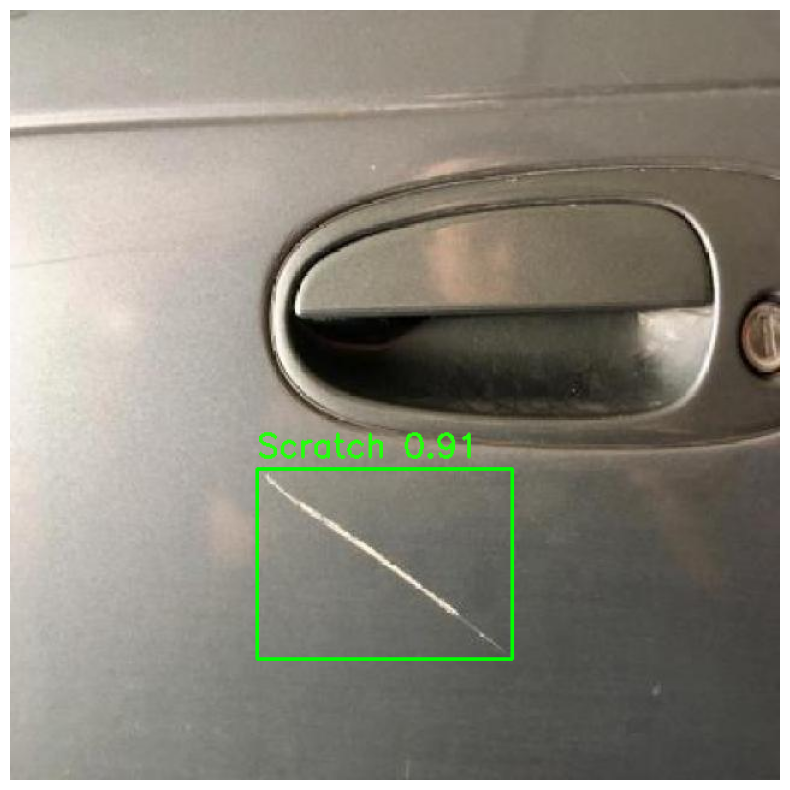


0: 640x640 1 Crack, 1 Paint-Crack, 37.1ms
Speed: 2.1ms preprocess, 37.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


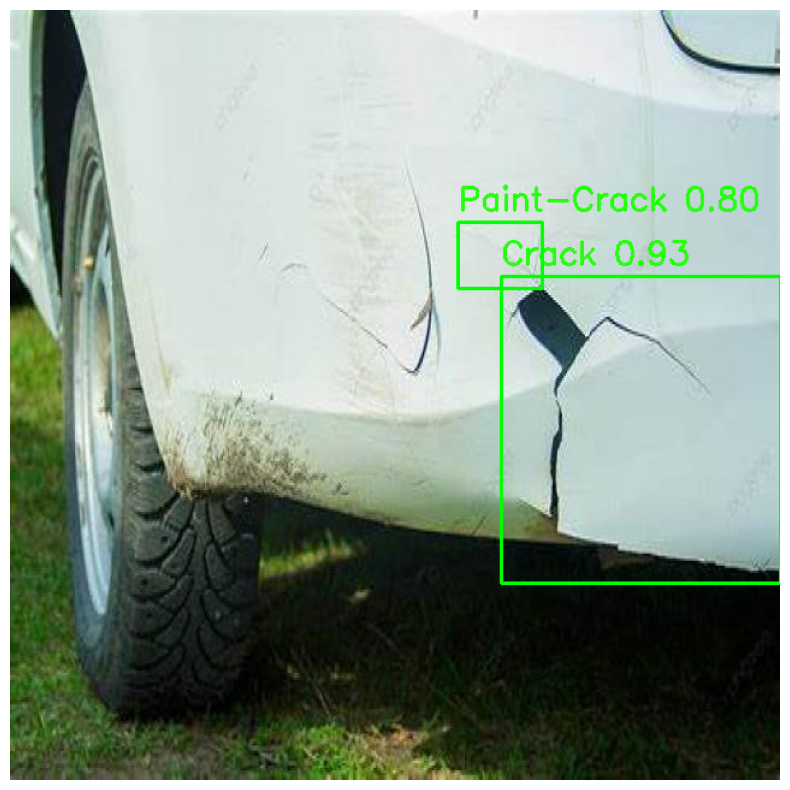


0: 640x640 1 Crack, 1 Rust, 37.1ms
Speed: 2.2ms preprocess, 37.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


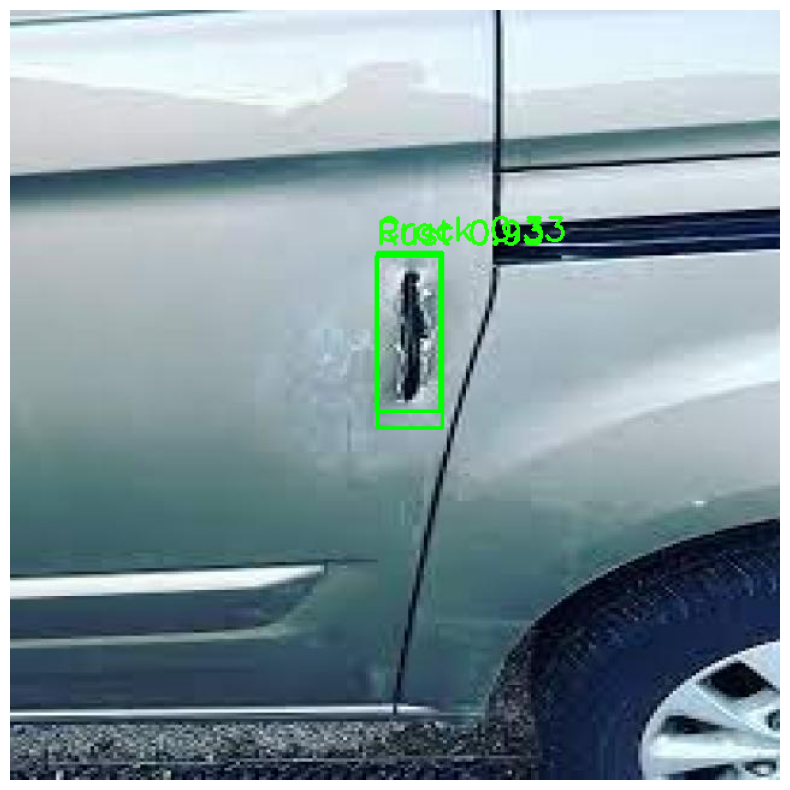


0: 640x640 1 Dent, 1 PDR-Dent, 38.9ms
Speed: 2.1ms preprocess, 38.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


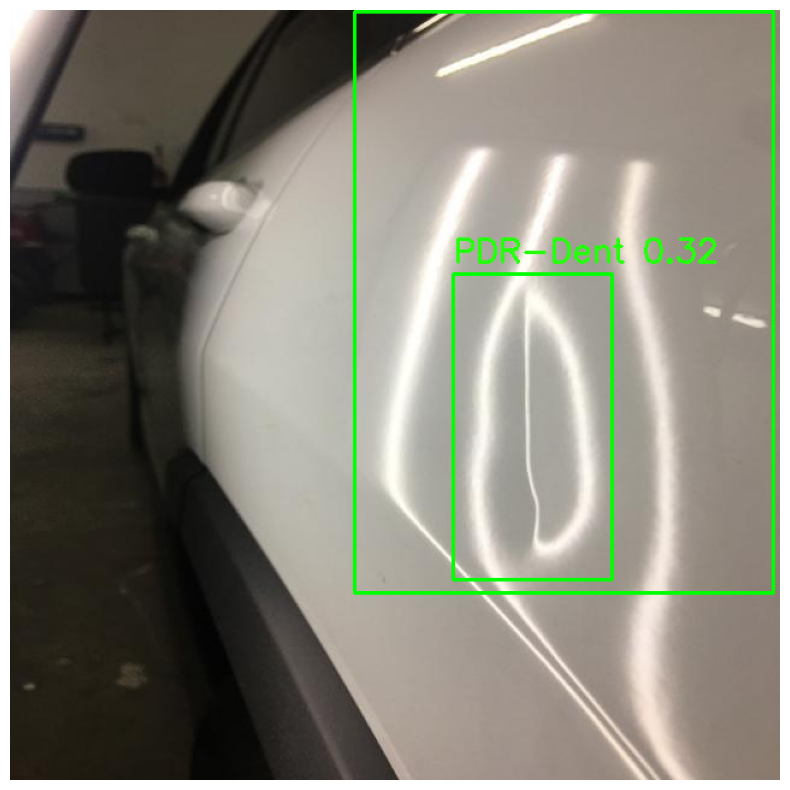


0: 640x640 1 Crack, 2 Rusts, 37.1ms
Speed: 2.2ms preprocess, 37.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


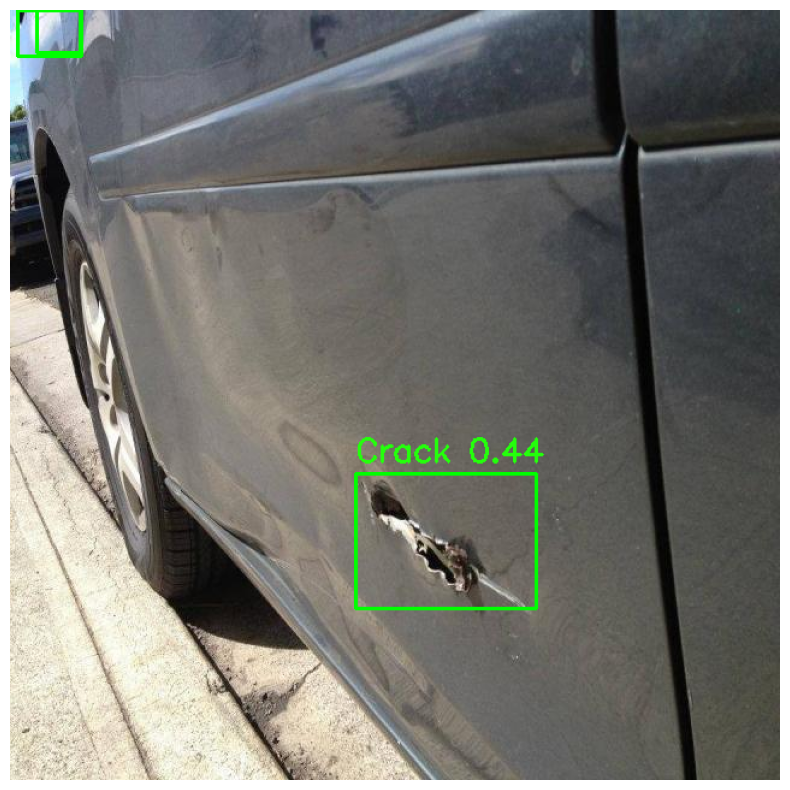


0: 640x640 1 Paint-Crack, 37.1ms
Speed: 2.1ms preprocess, 37.1ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


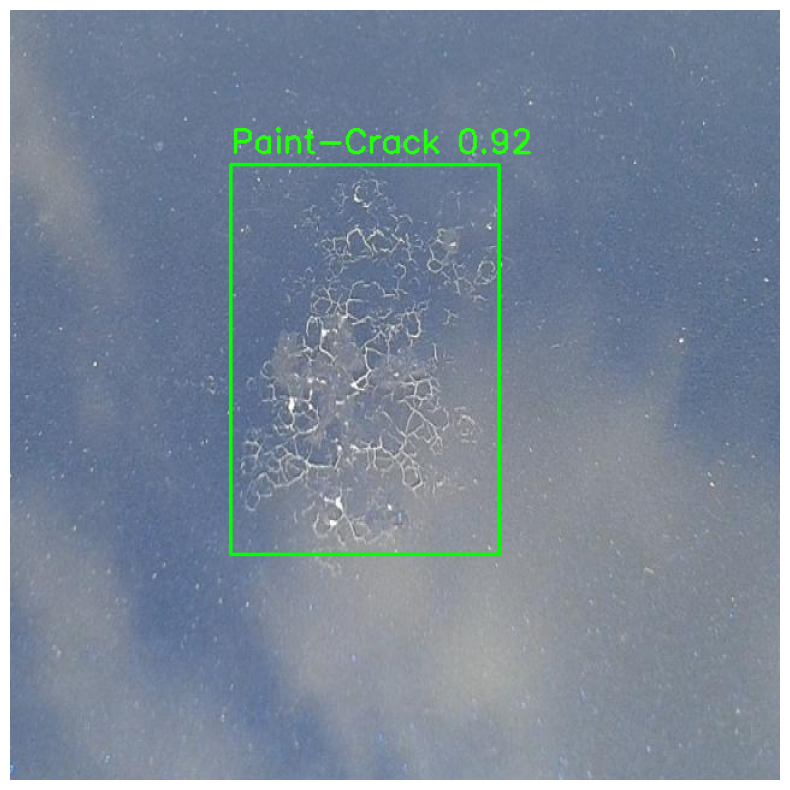


0: 640x640 1 Crack, 37.7ms
Speed: 2.2ms preprocess, 37.7ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


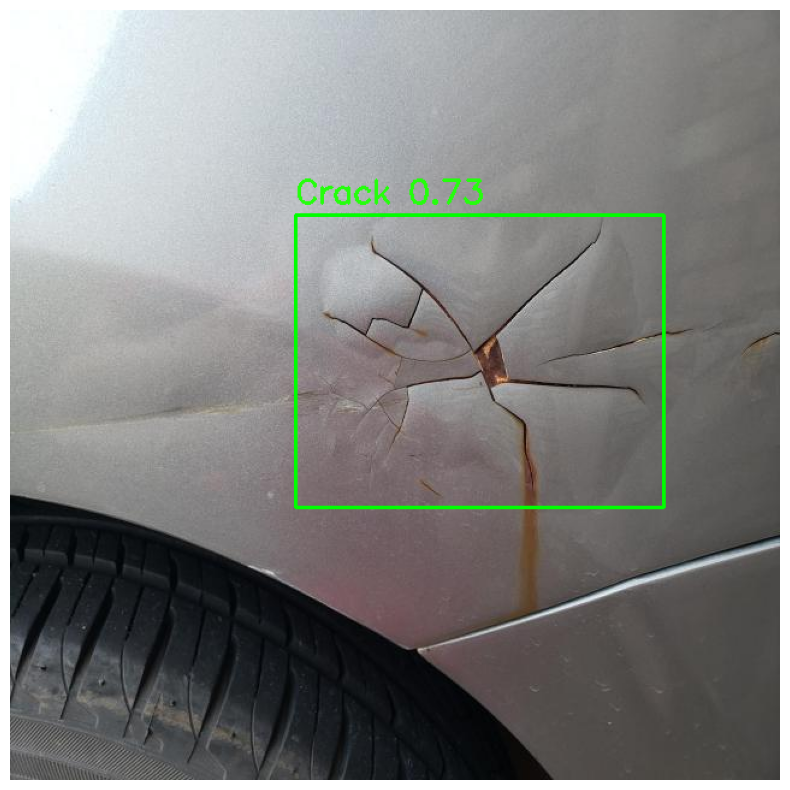


0: 640x640 1 Dent, 37.1ms
Speed: 2.2ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


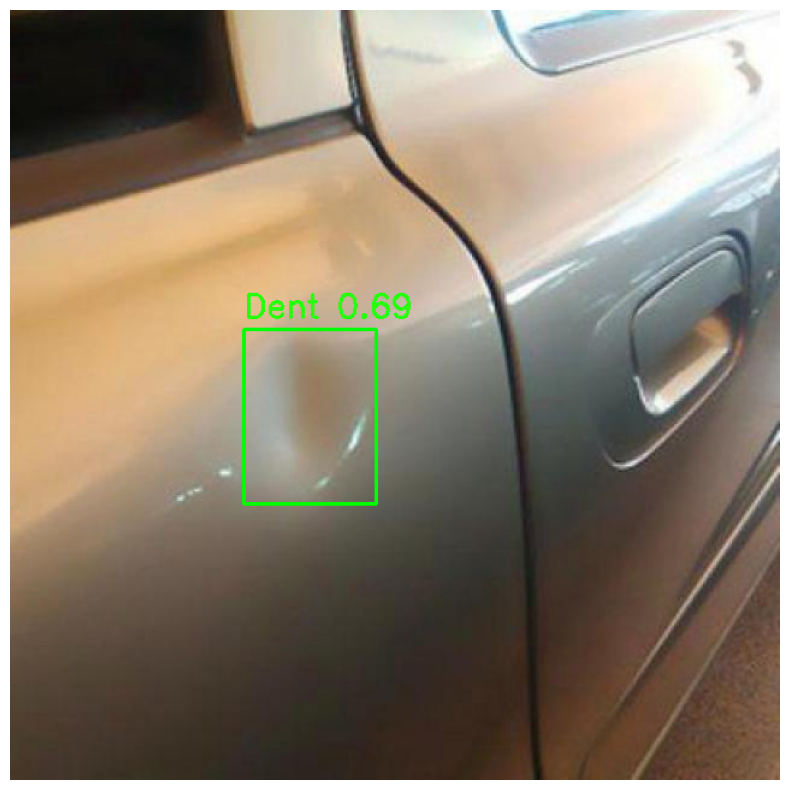


0: 640x640 1 Crack, 37.1ms
Speed: 2.2ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


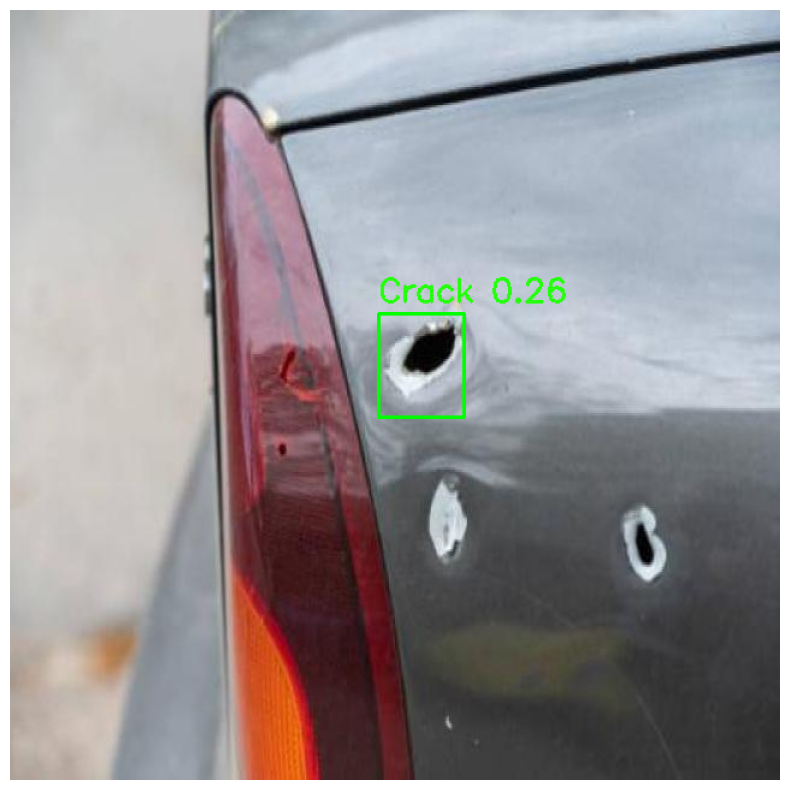


0: 640x640 1 PDR-Dent, 37.1ms
Speed: 2.1ms preprocess, 37.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


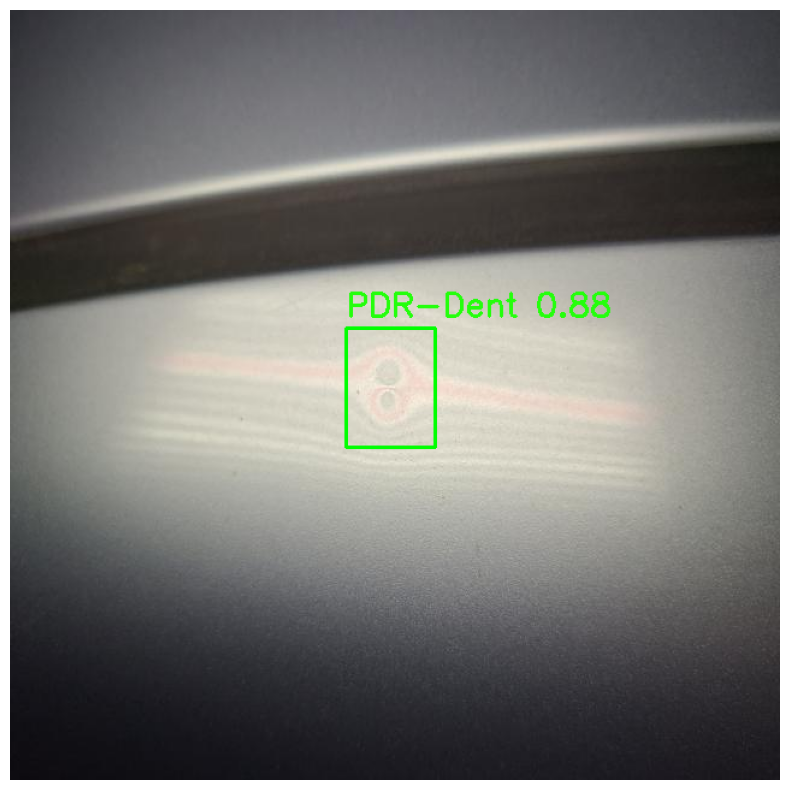


0: 640x640 2 PDR-Dents, 37.1ms
Speed: 2.2ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


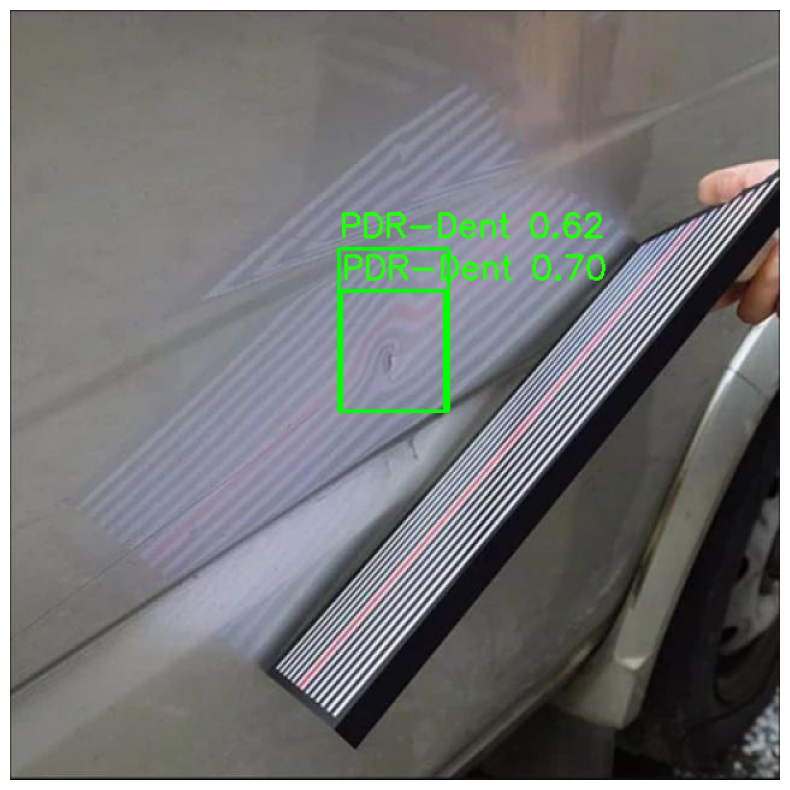


0: 640x640 (no detections), 37.2ms
Speed: 2.4ms preprocess, 37.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


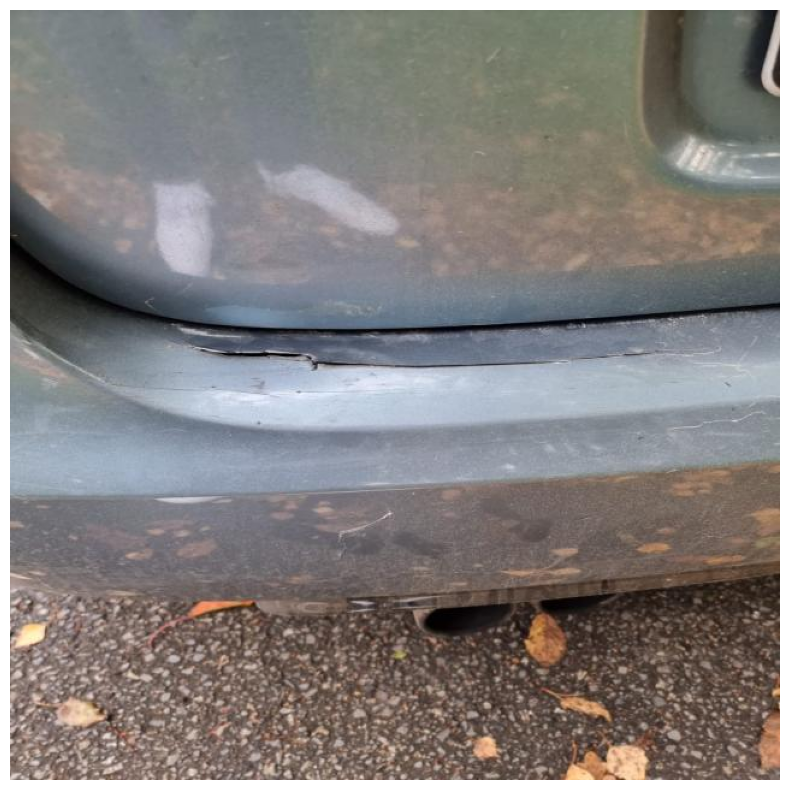


0: 640x640 1 Crack, 1 Scratch, 37.1ms
Speed: 2.2ms preprocess, 37.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


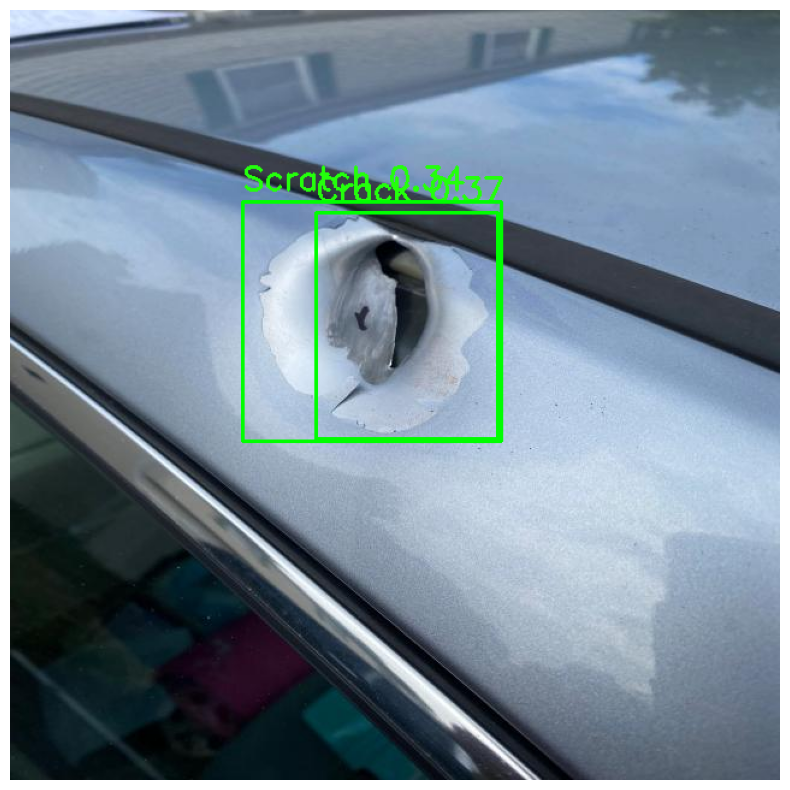


0: 640x640 1 Rust, 38.5ms
Speed: 2.1ms preprocess, 38.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


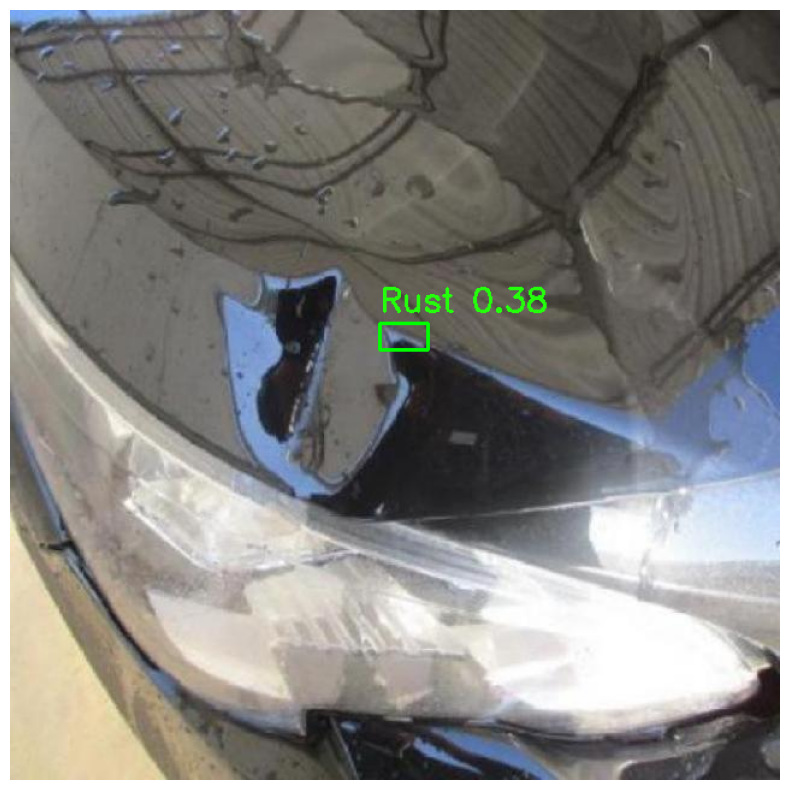


0: 640x640 1 Dent, 37.1ms
Speed: 2.5ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


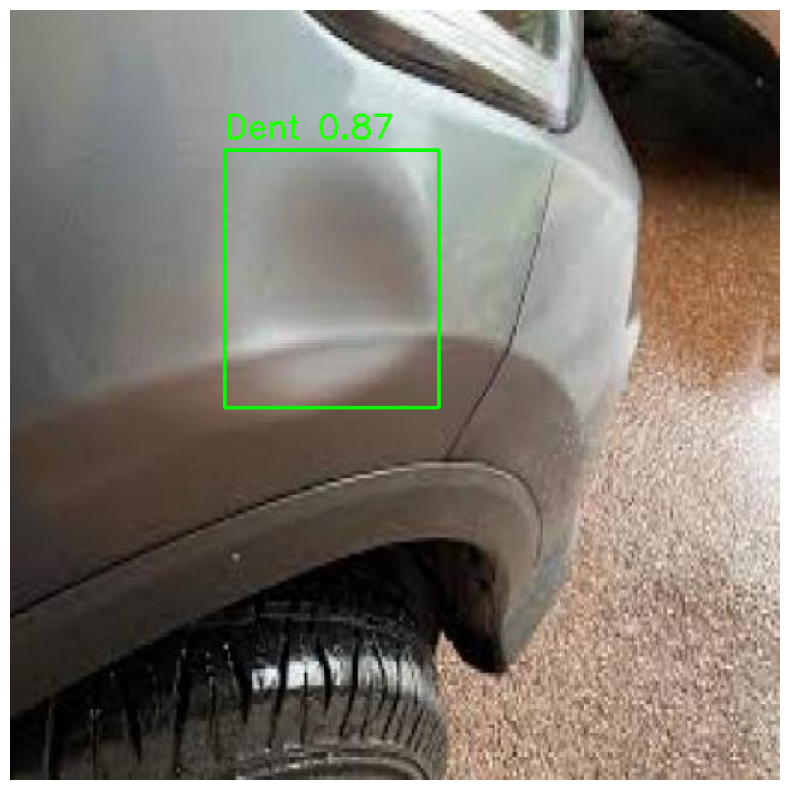


0: 640x640 1 Paint-fading, 37.4ms
Speed: 2.0ms preprocess, 37.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


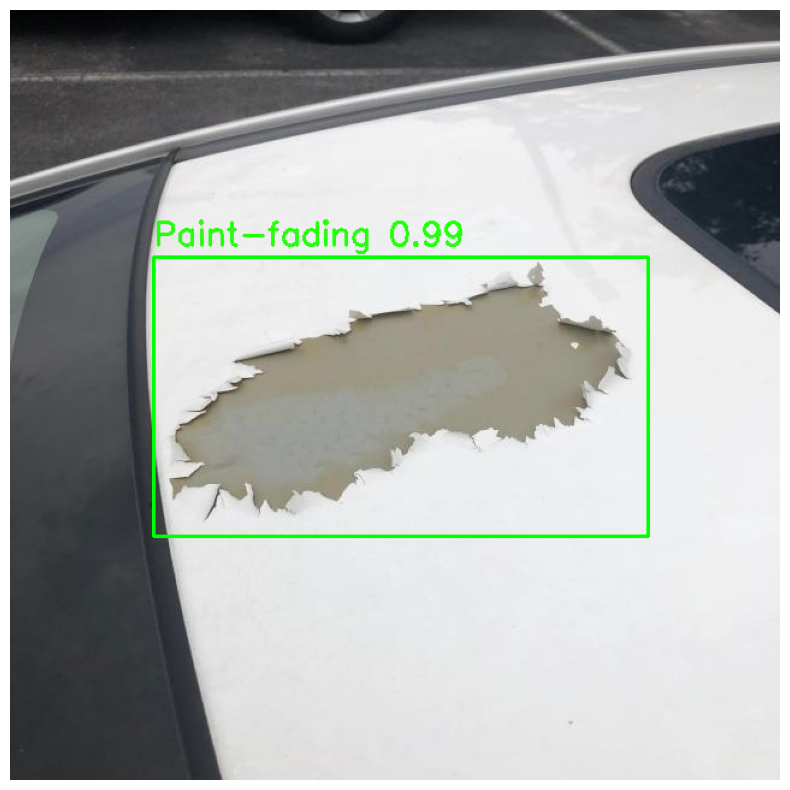


0: 640x640 1 Paint-Crack, 37.1ms
Speed: 2.4ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


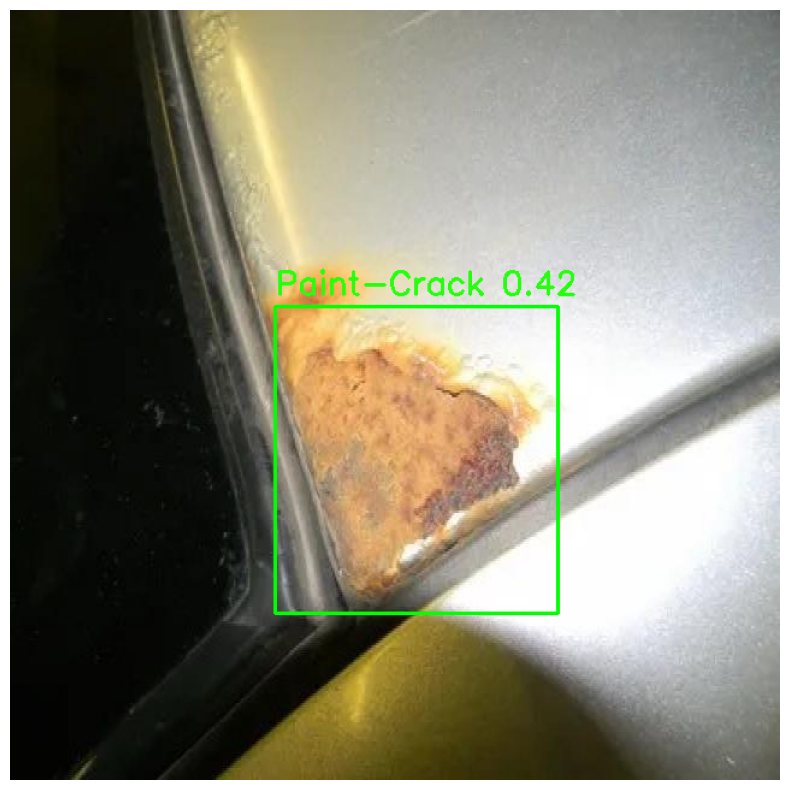


0: 640x640 1 Paint-Crack, 1 Scratch, 37.1ms
Speed: 2.1ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


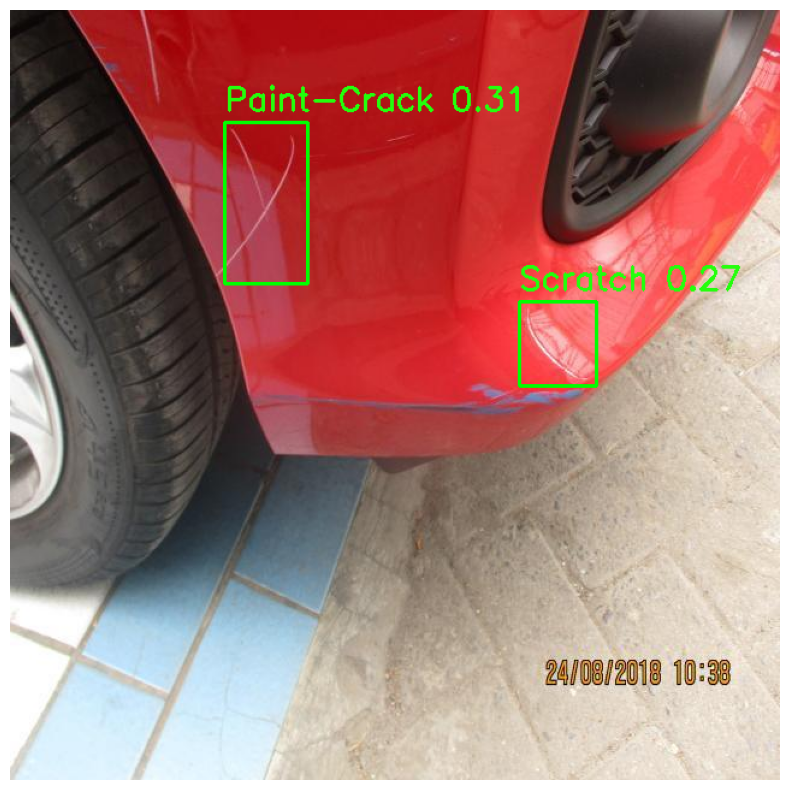


0: 640x640 (no detections), 37.6ms
Speed: 2.6ms preprocess, 37.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


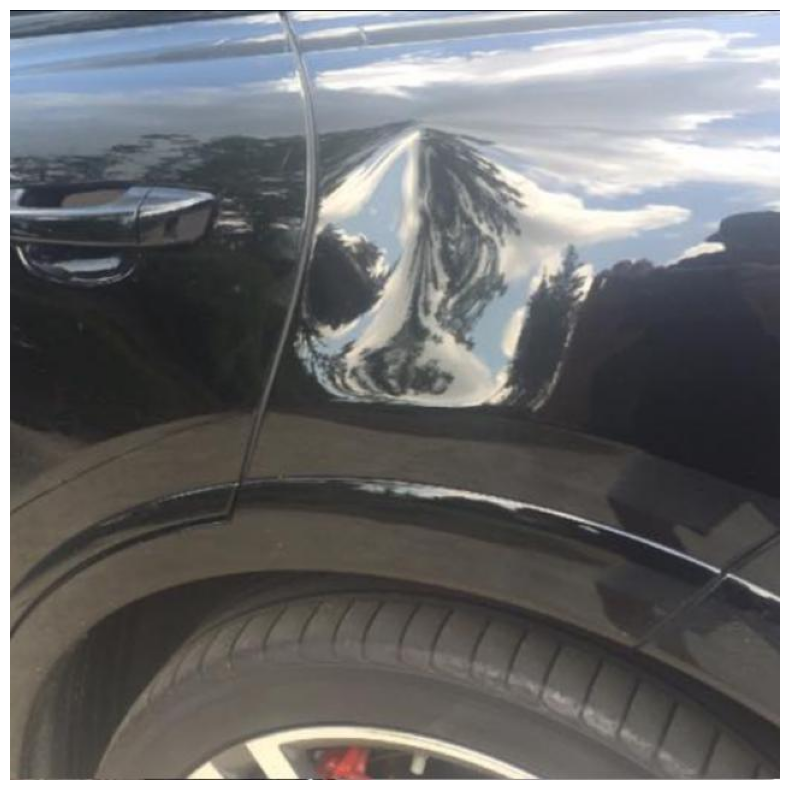


0: 640x640 1 Rust, 37.1ms
Speed: 2.0ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


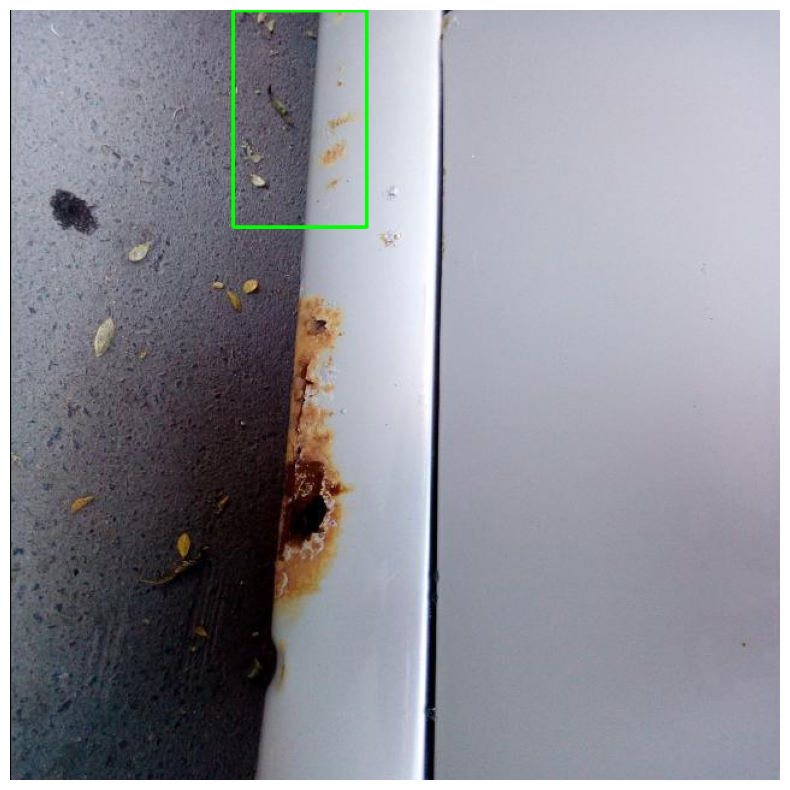


0: 640x640 4 Paint-Cracks, 37.2ms
Speed: 2.1ms preprocess, 37.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


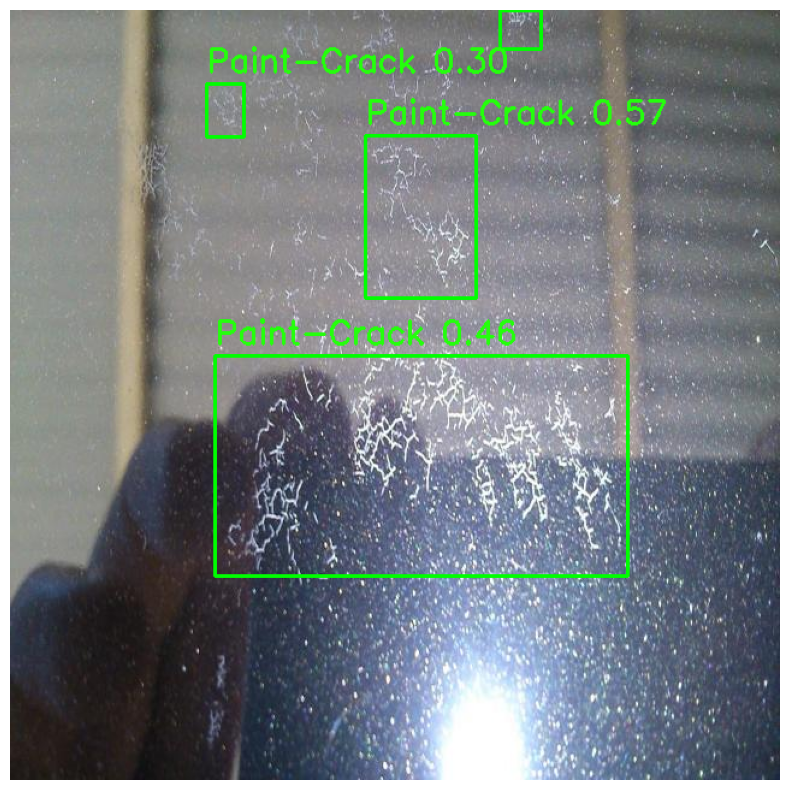


0: 640x640 (no detections), 37.1ms
Speed: 2.1ms preprocess, 37.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


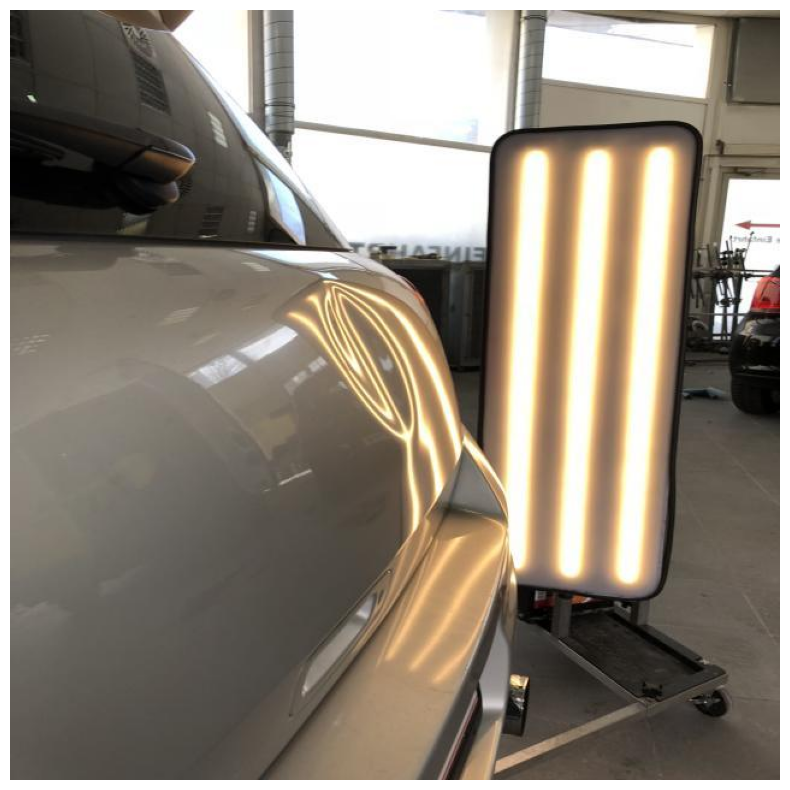

In [ ]:
# Load the model
model = YOLO('/content/runs/detect/train/weights/best.pt')

# Update the path to the test image directory
directory = data['test']

# Set the confidence threshold for predictions
confidence_threshold = 0.25

# Get a list of all the image files in the directory
image_files = [f for f in os.listdir(directory) if f.endswith('.jpg') or f.endswith('.png')]

# For each image file
for image_file in image_files:
    # Load the image
    img = cv2.imread(os.path.join(directory, image_file))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB

    # Predict the objects in the image
    results = model.predict(img)

    # Check if there are any results and process the first Results object
    if len(results) > 0:
        result = results[0]

        # Access the boxes attribute, ensure it is transferred to CPU and converted to numpy
        if hasattr(result, 'boxes') and result.boxes:
            detections = result.boxes.data.cpu().numpy()  # Transfer to CPU and convert to numpy

            # Iterate over each detection
            for detection in detections:
                conf = detection[4]  # Get the confidence score
                if conf > confidence_threshold:
                    x1, y1, x2, y2 = map(int, detection[:4])
                    label = result.names[int(detection[5])]

                    # Draw the bounding box and label on the image
                    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
                    cv2.putText(img, f"{label} {conf:.2f}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36, 255, 12), 2)

    # Show the image using matplotlib
    plt.figure(figsize=(12, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.show()


# Добавление обученной модели в ZIP

In [ ]:
# Zip the output directory
!zip -r /content/runs.zip ./runs

  adding: runs/ (stored 0%)
  adding: runs/detect/ (stored 0%)
  adding: runs/detect/val/ (stored 0%)
  adding: runs/detect/val/PR_curve.png (deflated 11%)
  adding: runs/detect/val/F1_curve.png (deflated 6%)
  adding: runs/detect/val/val_batch2_labels.jpg (deflated 9%)
  adding: runs/detect/val/val_batch1_pred.jpg (deflated 9%)
  adding: runs/detect/val/P_curve.png (deflated 6%)
  adding: runs/detect/val/confusion_matrix_normalized.png (deflated 21%)
  adding: runs/detect/val/confusion_matrix.png (deflated 26%)
  adding: runs/detect/val/val_batch0_pred.jpg (deflated 7%)
  adding: runs/detect/val/val_batch1_labels.jpg (deflated 10%)
  adding: runs/detect/val/val_batch0_labels.jpg (deflated 8%)
  adding: runs/detect/val/val_batch2_pred.jpg (deflated 9%)
  adding: runs/detect/val/R_curve.png (deflated 9%)
  adding: runs/detect/train/ (stored 0%)
  adding: runs/detect/train/events.out.tfevents.1733662609.74503208e9a1.1611.0 (deflated 88%)
  adding: runs/detect/train/labels_correlogram.jpg